# Network metrics in SC and FC

In [3]:
%cd work/notebooks

# Import modules and R
import numpy as np, pandas as pd
%load_ext rpy2.ipython
%load_ext autoreload
%autoreload 2

# Import local code
import sys
sys.path.append('/home/jovyan/work/code')
from gradientVersion import *
from processing_helpers import *
from analysis_helpers import *
from mri_maps import *
%R source("../code/Rplots.R");
%R source("../code/brainPlots.R");

/home/jovyan/work/notebooks


System has not been booted with systemd as init system (PID 1). Can't operate.
Failed to connect to bus: Host is down


In [1107]:
dme_3d_ds5 = gradientVersion().fit('hcp_3donors_ds5')
hcp_scores = dme_3d_ds5.clean_scores()
null_scores = np.load("../outputs/permutations/hcp_3d_ds5_spin_5000_v2.npy")

# dme_ds8 = gradientVersion().fit('hcp_ds8')
# hcp_scores = dme_ds8.clean_scores()
# null_scores = np.load("../outputs/permutations/hcp_ds8_spin_5000_v2.npy")
# dme_ds8 = gradientVersion().fit('hcp_ds8')
# dme_ds5 = gradientVersion().fit('hcp_ds5')

New gradients version: method=dm, kernel=normalized_angle, sparsity=0, data=hcp_3donors_ds5


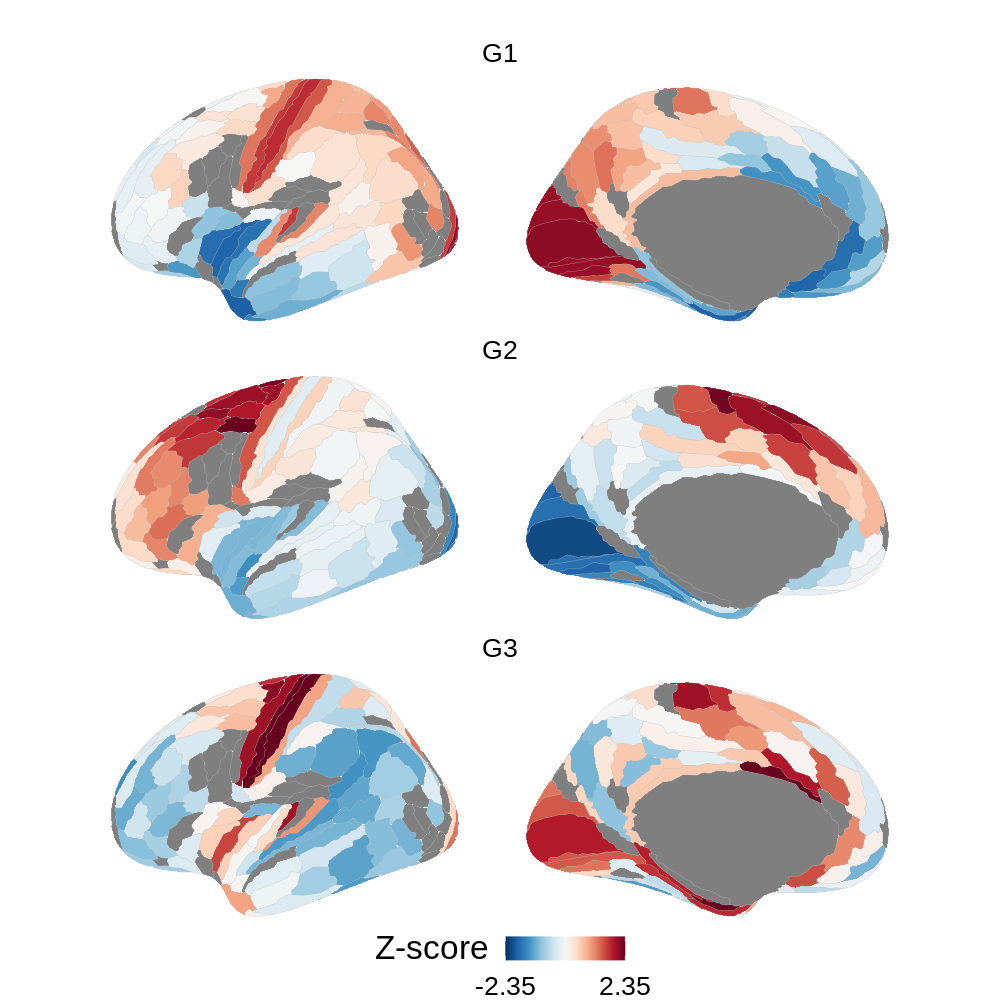

In [1441]:
%%R -i hcp_scores -w 10 -h 10 -u in -r 100
plot_hcp(hcp_scores, facet='w') + theme(text=element_text(size=24))

## Distances

In [1137]:
xyz = fetch_hcp()['info'].set_index('id').loc[:, ['x-cog','y-cog','z-cog']].set_axis(['x','y','z'],axis=1).iloc[:180].values
from sklearn.metrics.pairwise import euclidean_distances

hcp_euclidean = euclidean_distances(xyz,xyz)
hcp_geodesic = np.loadtxt("../data/parcellations/LeftParcelGeodesicDistmat.txt")

In [1138]:
from scipy.stats import pearsonr
pearsonr(hcp_euclidean.flatten(), hcp_geodesic.flatten())

PearsonRResult(statistic=0.8698092387972278, pvalue=0.0)

In [1147]:
distance_maps = (pd.DataFrame({
    'euclidean':hcp_euclidean.mean(0),
    'geodesic':hcp_geodesic.mean(0)
}, index=range(1,181))
.assign(label=get_labels_hcp()[:180])
.set_index('label')
.apply(lambda x: (x-np.mean(x))/np.std(x))
)

          euclidean  geodesic
euclidean 1.0000000 0.8078594
geodesic  0.8078594 1.0000000


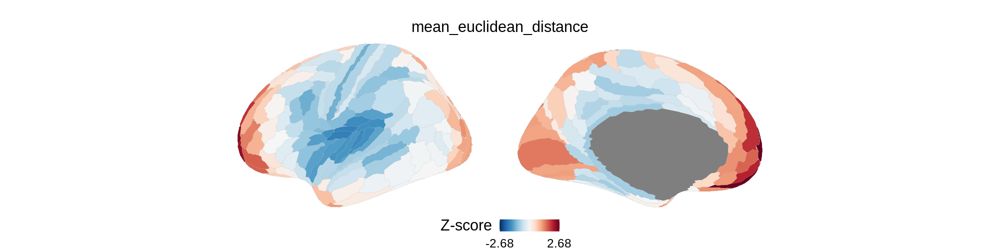

In [1459]:
%%R -i distance_maps -w 20 -h 5 -u in -r 100
print(distance_maps %>% cor(use='p'))
plot_maps(distance_maps %>% select(mean_euclidean_distance=euclidean))

## Compare different datasets

In [1561]:
networks = {
    'msn': pd.read_csv("../data/MeanMSN.HCP.CT_MC_SA_SD_Vol.csv", index_col=0).values[:180,:180]/2+.5,
    'mind_old_features': pd.read_csv("../data/MeanMIND.HCP.CT_MC_SA_SD_Vol.csv", index_col=0).values[:180,:180],
    'mind_new_features': pd.read_csv("../data/MeanMIND.HCP.CT_MC_MD_ICVF.not_normalized.csv", index_col=0).values[:180,:180],
    'dti_demirtas': nib.load("../data/average_sc.pconn.nii").get_fdata()[:180,:180],
    # 'dti_arnatkeviciute': pd.read_csv("../data/MeanDTI_arnatkeceviute.csv", index_col=0).values[:180,:180],
    # 'dti_enigma': pd.read_csv("../data/MeanDTI_enigma_toolbox.csv", index_col=0).values[:180,:180],
    # 'dti_prob_trac': pd.read_csv("../data/MeanDTI_prob_trac.csv", index_col=0).values[:180,:180],
    'dti_rosen': pd.read_csv("../data/averageConnectivity_Fpt.csv", index_col=0).values[:180,:180],
    # 'dti_demirtas': nib.load("../data/average_sc.pconn.nii").get_fdata()[:180,:180],
    'fmri_demirtas': nib.load("../data/average_fc.pconn.nii").get_fdata()[:180,:180],
}

for net in networks.values():
    np.fill_diagonal(net,np.nan)

# np.fill_diagonal(networks['msn'],0)

# networks['dti_prob_trac'] = np.clip(networks['dti_prob_trac'], a_min=-6, a_max=-1)
# np.fill_diagonal(networks['dti_rosen'], np.nan)
networks['dti_rosen'] = networks['dti_rosen']/(np.nanstd(networks['dti_rosen'])*10)
networks['dti_rosen'] = networks['dti_rosen'] - np.nanmin(networks['dti_rosen'])

# np.fill_diagonal(networks['dti_demirtas'], np.nan)
# networks['dti_demirtas'] = np.log10(networks['dti_demirtas']+.01)
# networks['dti_demirtas'] = networks['dti_demirtas']/(np.nanstd(networks['dti_demirtas'])*10)
# networks['dti_demirtas'] = networks['dti_demirtas'] - np.nanmin(networks['dti_demirtas'])

# np.fill_diagonal(networks['fmri_demirtas'],0)
networks['fmri_demirtas'] = np.clip(networks['fmri_demirtas'], a_min=0, a_max=None)

for net in networks.values():
    np.fill_diagonal(net, 0)

# networks['dti_prob_trac'] = networks['dti_prob_trac']/np.std(networks['dti_prob_trac'])

In [1562]:
pd.concat({name:pd.Series(net.flatten()) for name,net in networks.items()}, axis=1).describe()

,msn,mind_old_features,mind_new_features,dti_arnatkeviciute,dti_rosen,fmri_demirtas
count,32400.000000,32400.000000,32400.000000,32400.000000,32400.000000,32400.000000
mean,0.496309,0.119301,0.135511,0.341812,0.260213,0.172818
std,0.229648,0.037773,0.047364,0.177410,0.101602,0.122468
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.309492,0.092009,0.103828,0.190652,0.191984,0.081066
50%,0.493887,0.116676,0.131400,0.405290,0.250102,0.144671
75%,0.685813,0.145284,0.165177,0.492518,0.314184,0.242412
max,0.995880,0.294529,0.433282,0.632819,0.606102,0.827916


In [1563]:
df_corrs = pd.concat({name:pd.Series(net.flatten()) for name,net in networks.items()}, axis=1).rank().corr()
df_corrs

,msn,mind_old_features,mind_new_features,dti_arnatkeviciute,dti_rosen,fmri_demirtas
msn,1.000000,0.516875,0.279537,0.019866,0.044138,0.077479
mind_old_features,0.516875,1.000000,0.519466,0.116079,0.112939,0.136818
mind_new_features,0.279537,0.519466,1.000000,0.064292,0.078673,0.319682
dti_arnatkeviciute,0.019866,0.116079,0.064292,1.000000,0.322942,0.244204
dti_rosen,0.044138,0.112939,0.078673,0.322942,1.000000,0.105009
fmri_demirtas,0.077479,0.136818,0.319682,0.244204,0.105009,1.000000


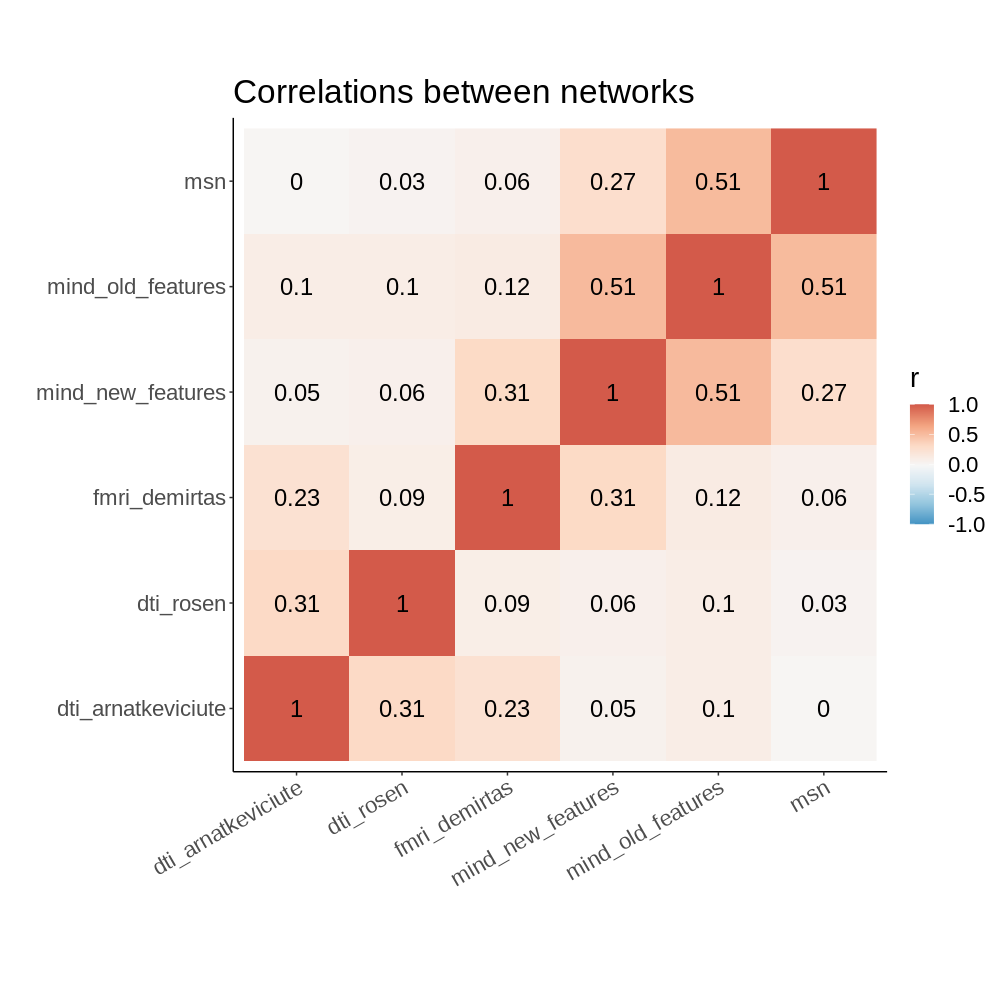

In [1547]:
%%R -i df_corrs -w 10 -h 10 -u in -r 100
df_corrs %>%
rownames_to_column('x') %>% 
pivot_longer(-x, names_to='y', values_to='r') %>% 
ggplot(aes(x,y)) + geom_raster(aes(fill=r)) + 
geom_text(aes(label=round(r,2)), size=6) + 
scale_fill_gradientn(colors=rev(brewer.rdbu(100)[20:80]), limits=c(-1,1)) +
xlab('') + ylab('') +
theme_classic() + 
theme(aspect.ratio=1,
    text=element_text(size=20),
    axis.text.x=element_text(angle=30, hjust=1)
) +
ggtitle('Correlations between networks')

### Compute modules?

Different for each network

In [1651]:
import bct
gamma = 1.06

for net in networks.values():
    np.fill_diagonal(net,0)

modules = {
    name:bct.community_louvain(net, gamma=gamma, seed=1)[0] 
    # name:bct.modularity_louvain_und(net, gamma=gamma)[0] 
    for name, net in networks.items()
}
modules

BCTParamError: Input connection matrix contains negative weights but objective function dealing with negative weights was not selected

### Use Yeo modules?

Same for each network

In [1564]:
yeo = pd.read_csv("../data/mesulam_ve_yeo.csv", index_col=0).iloc[:180,]
yeo_modules = yeo['Yeo'].values
yeo_names = yeo['Yeo_names'].values

df_modules = (get_labels_hcp()[:180].to_frame()
 .assign(module = yeo_modules)
 .assign(module_name = yeo_names)
 .sort_values('module')
)

modules = {name:yeo_modules for name,net in networks.items()}

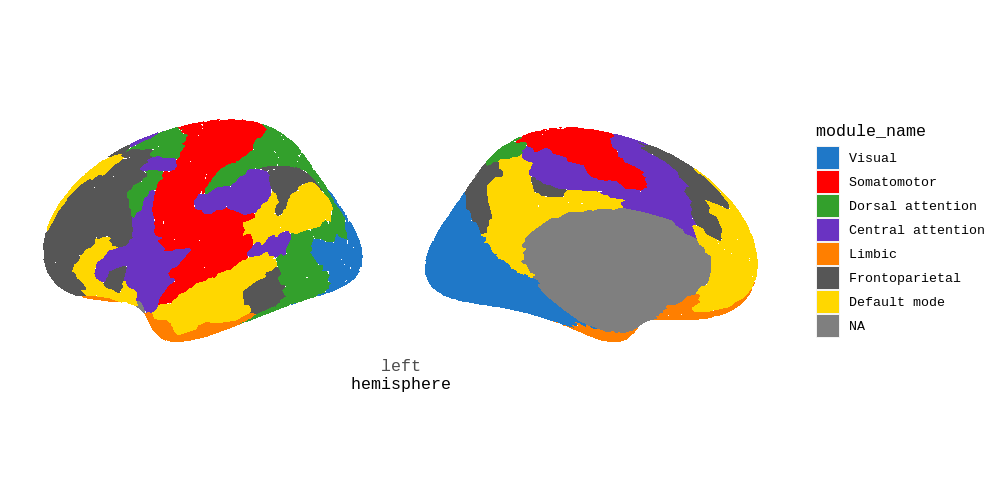

In [1362]:
%%R -i df_modules -w 10 -h 5 -u in -r 100
library(pals)
df_modules %>% rename(region=label) %>% 
mutate(module_name = factor(module_name, ordered=T, levels=unique(.$module_name))) %>% 
ggseg(atlas=glasser, hemi='left', mapping=aes(fill=module_name)) + 
scale_fill_manual(values=cols25(12))

### Use Ji modules

In [1370]:
ji_networks = np.loadtxt("../data/parcellations/cortex_parcel_network_assignments.txt")
ji_network_names = ['Primary Visual', 'Secondary Visual', 'Somatomotor', 'Cingulo-Opercular', 
                    'Dorsal-Attention', 'Language', 'Frontoparietal', 'Auditory',
                    'Default',  'Posterior Multimodal', 'Ventral Multimodal', 'Orbito-Affective']
names_map = {i+1:name for i,name in enumerate(ji_network_names)}

df_modules = (get_labels_hcp().to_frame()
 .assign(module = ji_networks)
 .assign(module_name = lambda x: x['module'].map(names_map))
 .sort_values('module')
)

modules = {name:ji_networks[:180] for name in networks.keys()}
modules['mind_new_features']

array([ 1.,  2.,  2.,  2.,  2.,  2.,  2.,  3.,  3.,  4.,  5.,  6.,  2.,
        7.,  7.,  2.,  2.,  2.,  2.,  2.,  2.,  2.,  2.,  8.,  6.,  6.,
       10.,  6.,  7.,  9.,  9.,  9.,  9.,  9.,  9.,  3.,  4.,  4.,  3.,
        3.,  3.,  3.,  4.,  4.,  4.,  5.,  3.,  2.,  2.,  5.,  3.,  3.,
        3.,  3.,  3.,  3.,  4.,  4.,  4.,  4.,  9.,  9.,  7.,  9.,  9.,
        9.,  9.,  9.,  9.,  9.,  9.,  9.,  7.,  6.,  6.,  9.,  7.,  4.,
        6.,  7.,  6.,  7.,  7.,  4.,  7.,  4.,  9.,  9.,  7.,  9.,  7.,
        7.,  9.,  9.,  5.,  5.,  7.,  7.,  4.,  3.,  3.,  3.,  8.,  8.,
        4.,  4.,  8.,  4.,  4., 12.,  7., 12.,  4.,  4.,  3.,  5.,  5.,
        9.,  9.,  9.,  1., 11.,  6.,  8.,  6.,  9.,  5.,  6.,  6.,  9.,
        9.,  9.,  7.,  9., 11.,  5.,  5.,  2.,  6., 10., 10.,  1.,  5.,
        7.,  7.,  5.,  4.,  4.,  7.,  9.,  9.,  2.,  2.,  2.,  9.,  2.,
        2.,  2.,  2.,  2.,  9.,  9.,  2.,  9.,  9., 12.,  4.,  3.,  4.,
        7.,  7.,  6.,  8.,  8.,  8.,  9.,  9.,  4.,  4.,  4.])

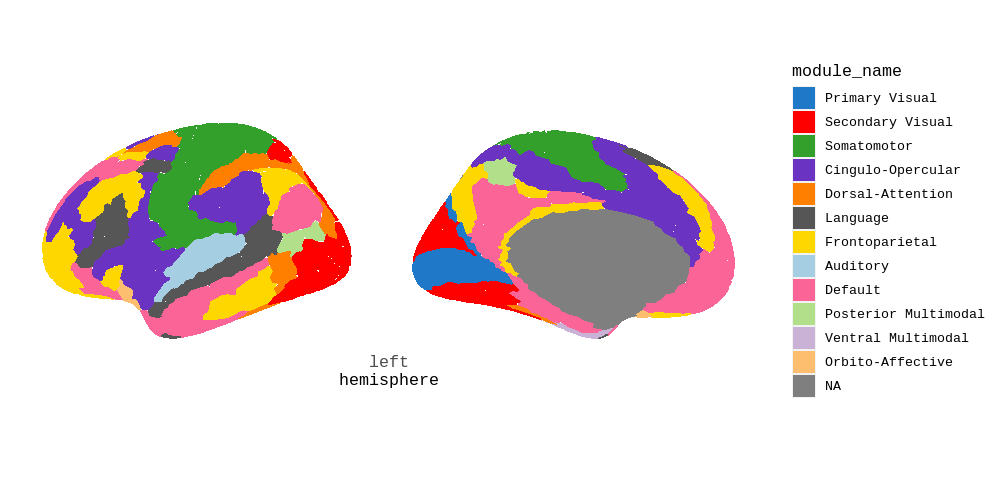

In [1371]:
%%R -i df_modules -w 10 -h 5 -u in -r 100
library(pals)
df_modules %>% rename(region=label) %>% 
mutate(module_name = factor(module_name, ordered=T, levels=unique(.$module_name))) %>% 
ggseg(atlas=glasser, hemi='left', mapping=aes(fill=module_name)) + 
scale_fill_manual(values=cols25(12))

## Plot networks

In [1421]:
networks_sorted = {name:net[modules[name].argsort(),:][:,modules[name].argsort()]
                   for name, net in networks.items()}

In [1422]:
networks_df = (pd.DataFrame({name:net.flatten() for name, net in networks_sorted.items()}, 
                index=pd.MultiIndex.from_product([range(180),range(180)], names=['x','y']))
                # .apply(lambda x: x/np.std(x))
                # .apply(lambda x: (x-np.mean(x))/np.std(x))
                # .apply(lambda x: x.clip(upper=np.quantile(x,.99), lower=np.quantile(x,.01)))
                )
networks_df_plot = (networks_df
                    # .apply(lambda x: x/np.std(x))
                    # .apply(lambda x: x.clip(upper=np.quantile(x,.95), lower=None))#np.quantile(x,.05)))
                    .apply(lambda x: (x-np.mean(x))/np.std(x))
                    .reset_index()
)

networks_df_plot.describe()

,x,y,msn,mind_old_features,mind_new_features,dti_rosen,dti_demirtas,fmri_demirtas
count,32400.000000,32400.000000,3.240000e+04,3.240000e+04,3.240000e+04,3.240000e+04,3.240000e+04,3.240000e+04
mean,89.500000,89.500000,-1.348778e-14,2.898236e-14,1.253676e-14,2.002084e-14,8.812532e-15,2.285209e-16
std,51.961524,51.961524,1.000015e+00,1.000015e+00,1.000015e+00,1.000015e+00,1.000015e+00,1.000015e+00
min,0.000000,0.000000,-2.161205e+00,-3.158369e+00,-2.861084e+00,-2.561135e+00,-8.826402e-01,-1.411148e+00
25%,44.750000,44.750000,-8.135046e-01,-7.225198e-01,-6.689448e-01,-6.715423e-01,-7.470334e-01,-7.492008e-01
50%,89.500000,89.500000,-1.054441e-02,-6.949948e-02,-8.680055e-02,-9.952082e-02,-3.714584e-01,-2.298385e-01
75%,134.250000,134.250000,8.252077e-01,6.878723e-01,6.263496e-01,5.311996e-01,4.230411e-01,5.682685e-01
max,179.000000,179.000000,2.175412e+00,4.638991e+00,6.286902e+00,3.404391e+00,4.650938e+00,5.349216e+00


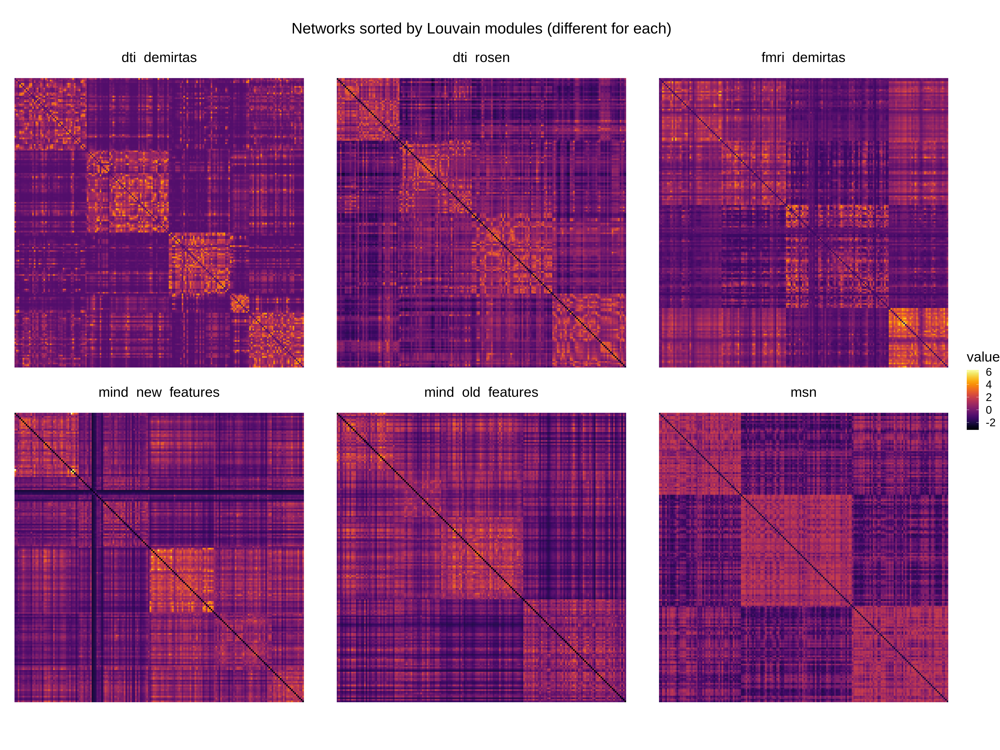

In [1423]:
%%R -i networks_df_plot -w 20 -h 15 -u in -r 200
networks_df_plot %>% 
# select(x,y,dti_prob_trac,dti_rosen) %>% 
pivot_longer(-c('x','y'), names_to='network', values_to='value') %>% 
ggplot(aes(x,y,fill=value)) +
facet_wrap(~network) +
geom_raster() + 
scale_fill_gradientn(colors=inferno(100)) +
scale_y_reverse() +
theme_void() + 
theme(
    text=element_text(size=20),
    strip.text=element_text(size=20),
    aspect.ratio=1,
    plot.title=element_text(hjust=0.5, vjust=5, size=22)
    ) +
ggtitle('Networks sorted by Louvain modules (different for each)')

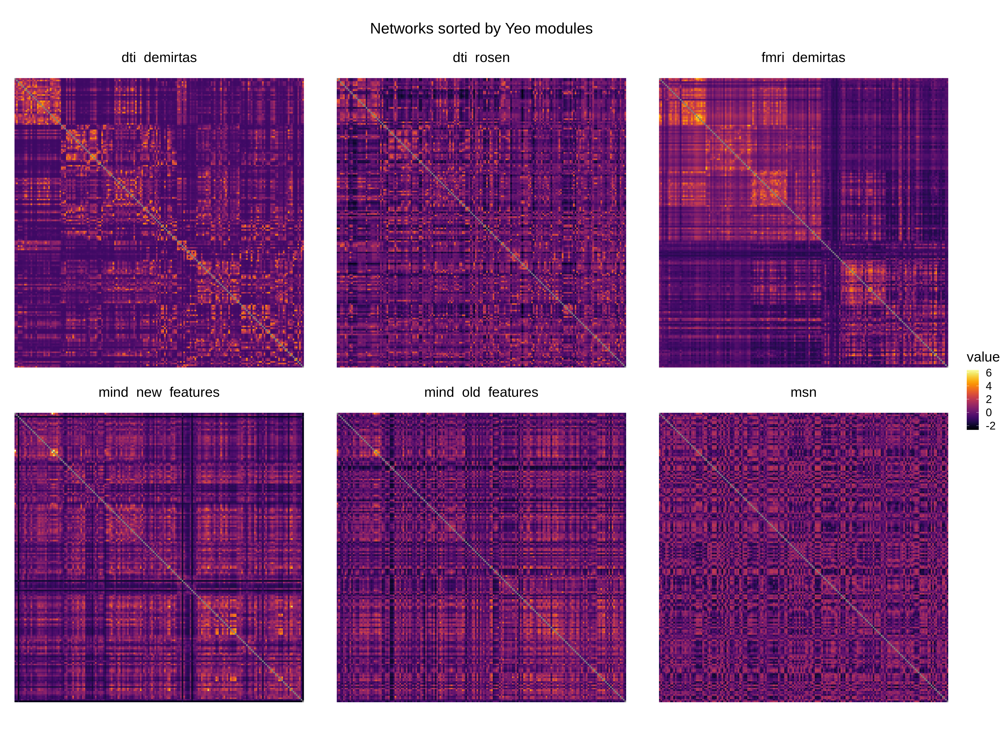

In [ ]:
%%R -i networks_df_plot -w 20 -h 15 -u in -r 200
networks_df_plot %>% 
# select(x,y,dti_prob_trac,dti_rosen) %>% 
pivot_longer(-c('x','y'), names_to='network', values_to='value') %>% 
ggplot(aes(x,y,fill=value)) +
facet_wrap(~network) +
geom_raster() + 
scale_fill_gradientn(colors=inferno(100)) +
scale_y_reverse() +
theme_void() + 
theme(
    text=element_text(size=20),
    strip.text=element_text(size=20),
    aspect.ratio=1,
    plot.title=element_text(hjust=0.5, vjust=5, size=22)
    ) +
ggtitle('Networks sorted by Yeo modules')

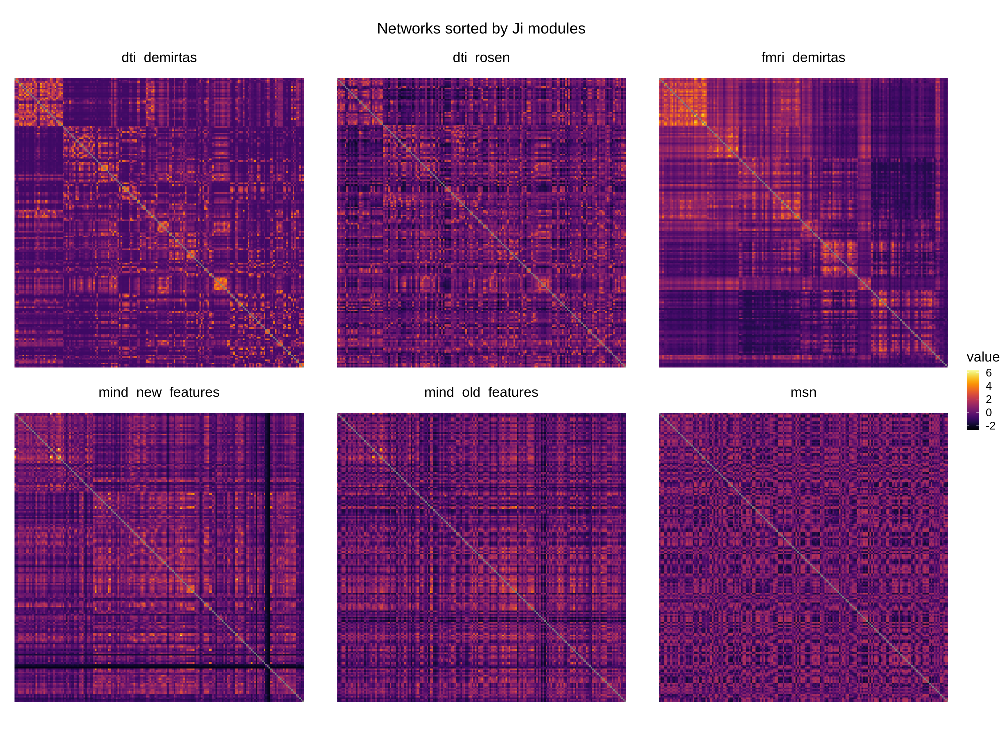

In [1374]:
%%R -i networks_df_plot -w 20 -h 15 -u in -r 200
networks_df_plot %>% 
# select(x,y,dti_prob_trac,dti_rosen) %>% 
pivot_longer(-c('x','y'), names_to='network', values_to='value') %>% 
ggplot(aes(x,y,fill=value)) +
facet_wrap(~network) +
geom_raster() + 
scale_fill_gradientn(colors=inferno(100)) +
scale_y_reverse() +
theme_void() + 
theme(
    text=element_text(size=20),
    strip.text=element_text(size=20),
    aspect.ratio=1,
    plot.title=element_text(hjust=0.5, vjust=5, size=22)
    ) +
ggtitle('Networks sorted by Ji modules')

## Node strengths

In [1565]:
# pd.concat({name:pd.Series(bct.degree.strengths_und(net)) for name, net in networks.items()}, axis=1)
strengths = (pd.DataFrame({name:pd.Series(net.sum(0)) 
                          for name, net in networks.items()})
             .set_index(get_labels_hcp()[:180])
             .apply(lambda x: (x-np.mean(x))/np.std(x))
        )

maps = strengths

In [1550]:
%%R -i strengths -w 20 -h 10 -u in -r 100
source("../code/plot_maps.R")
# g1 <- strengths %>% 
#     pivot_longer(everything(), names_to='map') %>% 
#     mutate_at(vars(map), ~ factor(., levels=unique(.))) %>% 
#     ggplot(aes(value)) + facet_wrap(~map, dir='v') + 
#     xlab('node strength z-score') +
#     geom_histogram() + theme_classic()

g2 <- plot_maps(strengths, ncol=1)

# ((g1 / g2) + plot_layout(heights=c(2,3))) & 
# theme(text=element_text(size=20))

In [1566]:
scatter = (maps
    .melt(ignore_index=False, var_name='map', value_name='map_score')
    .join(hcp_scores.set_index('label'))
    .melt(ignore_index=False, id_vars=['map','map_score'], var_name='G', value_name='G_score')
)

In [1567]:
null_p = (corr_nulls_from_grads(null_scores, hcp_scores, maps, method='pearsonr')
                .join(scatter.groupby(['map','G']).min(), on=('map','G'))
                .rename({'map_score':'y', 'G_score':'x'},axis=1)
)

In [1568]:
strengths.corr()

,msn,mind_old_features,mind_new_features,dti_arnatkeviciute,dti_rosen,fmri_demirtas
msn,1.000000,-0.290783,-0.079929,-0.479548,-0.188798,-0.230739
mind_old_features,-0.290783,1.000000,0.553826,0.216700,0.186474,0.188075
mind_new_features,-0.079929,0.553826,1.000000,0.123111,0.069412,0.439982
dti_arnatkeviciute,-0.479548,0.216700,0.123111,1.000000,0.399921,0.297502
dti_rosen,-0.188798,0.186474,0.069412,0.399921,1.000000,0.053427
fmri_demirtas,-0.230739,0.188075,0.439982,0.297502,0.053427,1.000000


/opt/conda/lib/python3.10/site-packages/rpy2/robjects/pandas2ri.py:56: UserWarning: DataFrame contains duplicated elements in the index, which will lead to loss of the row names in the resulting data.frame
  warnings.warn('DataFrame contains duplicated elements in the index, '




`geom_smooth()` using formula = 'y ~ x'


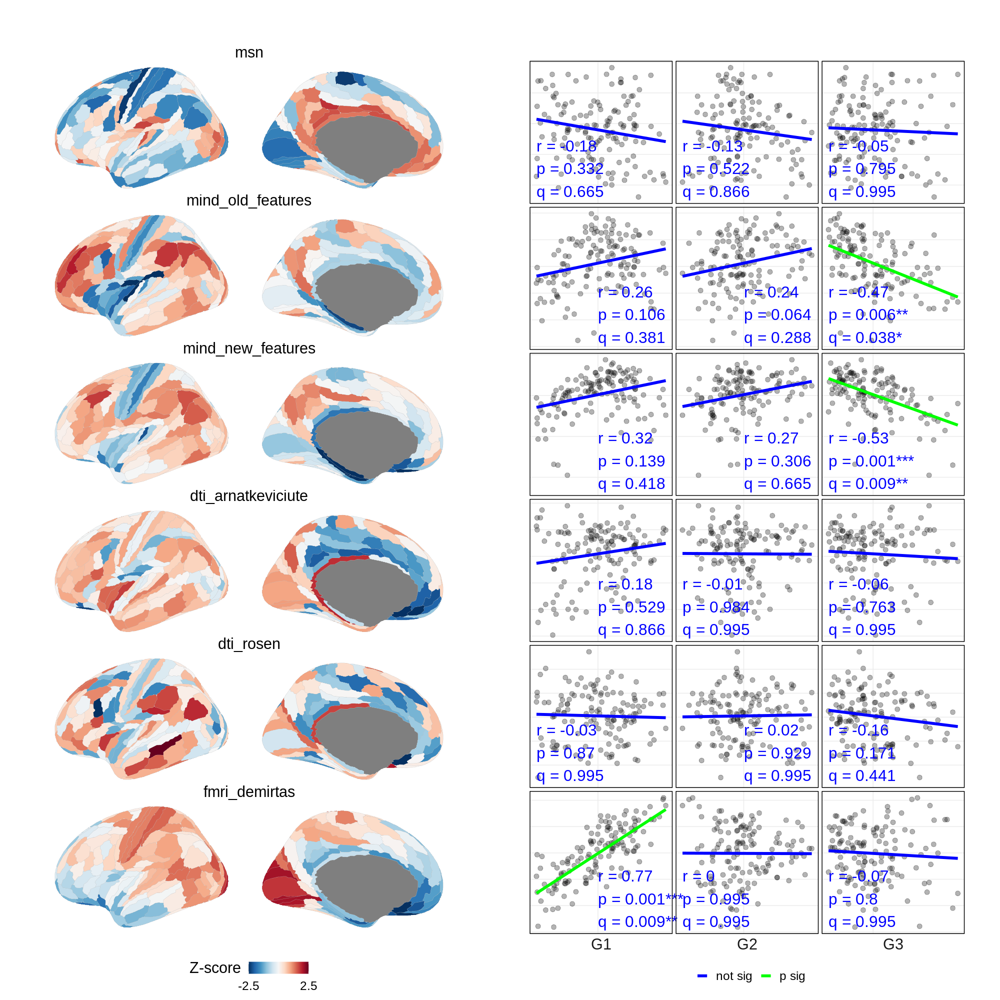

In [1569]:
%%R -i hcp_scores -i maps -i scatter -i null_p -w 20 -h 20 --units in -r 100
source("../code/plot_maps.R")
g0 <- plot_hcp_wide(hcp_scores)
g1 <- plot_maps(maps, ncol=1) & theme(strip.text=element_text(size=22))

# g2 <- maps %>% 
#     pivot_longer(everything(), names_to='map') %>% 
#     mutate_at(vars(map), ~ factor(., levels=unique(.))) %>% 
#     ggplot(aes(value)) + facet_wrap(~map, dir='v', ncol=1) + 
#     xlab('z-score') +
#     geom_histogram() + theme_bw()

g3 <- plot_maps_scatter(scatter, null_p) + theme(text=element_text(size=22), strip.text.y.left=element_blank())

# (g0 / (g1 + g3)) + plot_layout(heights=c(1,4))
g1 + g3

## Distance-weighted strength

In [1454]:
distance = hcp_geodesic

distance_weighted = (pd.DataFrame({name:pd.Series((net * distance).sum(0)) 
                          for name, net in networks.items()})
             .set_index(get_labels_hcp()[:180])
             .apply(lambda x: (x-np.mean(x))/np.std(x))
        )

maps = distance_weighted

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.


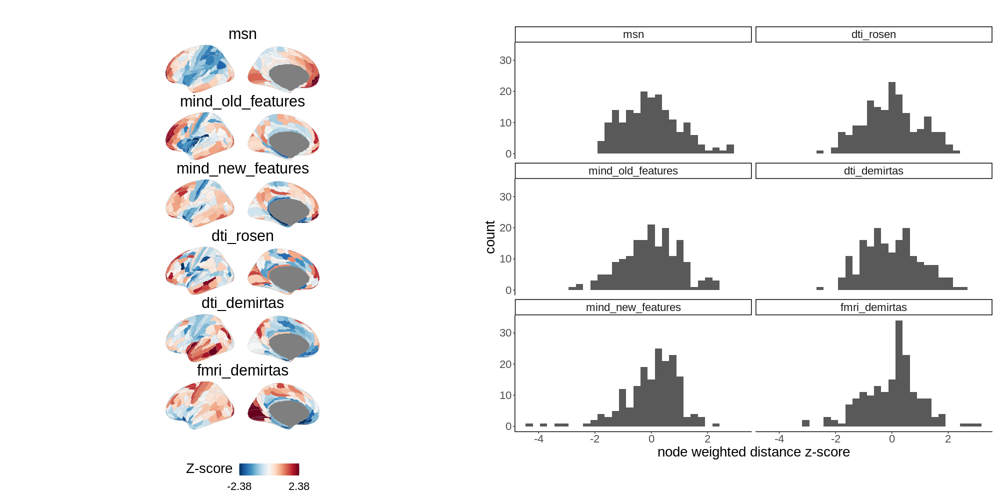

In [1455]:
%%R -i maps -w 20 -h 10 -u in -r 100
source("../code/plot_maps.R")

g1 <- plot_maps(maps, ncol=1)

g2 <- maps %>% 
    pivot_longer(everything(), names_to='map') %>% 
    mutate_at(vars(map), ~ factor(., levels=unique(.))) %>% 
    ggplot(aes(value)) + facet_wrap(~map, dir='v') + 
    xlab('node weighted distance z-score') +
    geom_histogram() + theme_classic()

((g1 | g2) + plot_layout(heights=c(2,3))) & 
theme(text=element_text(size=20))

In [1456]:
scatter = (maps
    .melt(ignore_index=False, var_name='map', value_name='map_score')
    .join(hcp_scores.set_index('label'))
    .melt(ignore_index=False, id_vars=['map','map_score'], var_name='G', value_name='G_score')
)

In [1457]:
null_p = (corr_nulls_from_grads(null_scores, hcp_scores, maps, method='pearsonr')
                .join(scatter.groupby(['map','G']).min(), on=('map','G'))
                .rename({'map_score':'y', 'G_score':'x'},axis=1)
)

/opt/conda/lib/python3.10/site-packages/rpy2/robjects/pandas2ri.py:56: UserWarning: DataFrame contains duplicated elements in the index, which will lead to loss of the row names in the resulting data.frame
  warnings.warn('DataFrame contains duplicated elements in the index, '




`geom_smooth()` using formula = 'y ~ x'


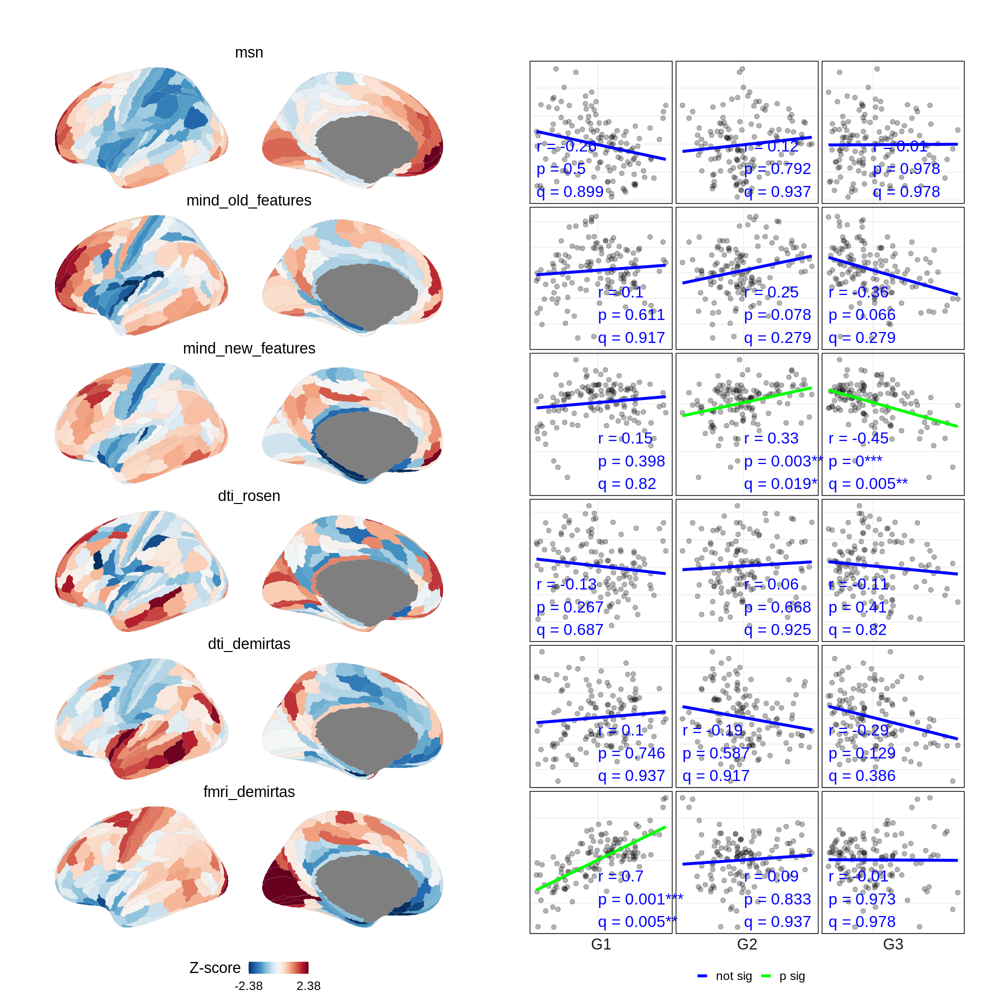

In [1458]:
%%R -i hcp_scores -i maps -i scatter -i null_p -w 20 -h 20 --units in -r 100
source("../code/plot_maps.R")
g0 <- plot_hcp_wide(hcp_scores)
g1 <- plot_maps(maps, ncol=1) & theme(strip.text=element_text(size=22))
g2 <- plot_maps_scatter(scatter, null_p) & theme(text=element_text(size=22), strip.text.y.left=element_blank())
# (g0 / (g1 + g2)) + plot_layout(heights=c(1,4))

g1 + g2

## Module strengths

In [1461]:
def edges_by_module(net, modules, how='intra'):
    # Edge matrix of whether nodes are in same module
    same_module = np.subtract.outer(modules, modules)==0
    if how=='intra':
        return np.where(same_module, net, 0)
    elif how=='inter':
        return np.where(~same_module, net, 0)

In [1467]:
strengths_intra = (pd.DataFrame({name:pd.Series(edges_by_module(net, modules[name], how='intra').sum(0))
                          for name, net in networks.items()})
             .set_index(get_labels_hcp()[:180])
             .apply(lambda x: (x-np.mean(x))/np.std(x))
        )

strengths_inter = (pd.DataFrame({name:pd.Series(edges_by_module(net, modules[name], how='inter').sum(0))
                          for name, net in networks.items()})
             .set_index(get_labels_hcp()[:180])
             .apply(lambda x: (x-np.mean(x))/np.std(x))
        )

maps = pd.concat({
    # 'intra': strengths_intra,
    'inter': strengths_inter
}, axis=1).droplevel(0,axis=1)
# maps.columns = maps.columns.map(lambda x: '-'.join([str(i) for i in x]))

maps
    

,msn,mind_old_features,mind_new_features,dti_rosen,dti_demirtas,fmri_demirtas
label,,,,,,
V1,-0.034724,0.120901,-1.241649,-0.285911,-0.880390,1.822702
MST,-1.344196,-0.978124,0.624708,0.298816,0.191440,0.705750
V6,-0.477298,0.401340,-0.475593,0.762913,-0.763023,1.165170
V2,-0.083472,0.200263,-0.865698,0.693537,-0.966682,1.779620
V3,-0.088566,0.738380,-0.283946,-0.014940,-0.787638,1.635144
...,...,...,...,...,...,...
STSva,-1.502965,-0.612140,0.861641,0.467920,0.957207,-0.765459
TE1m,0.048732,0.007102,0.131337,0.932815,2.009428,-1.800996
PI,-1.339397,-1.151175,-0.275579,-1.101091,1.033236,-0.616556


In [1468]:
scatter = (maps
    .melt(ignore_index=False, var_name='map', value_name='map_score')
    .join(hcp_scores.set_index('label'))
    .melt(ignore_index=False, id_vars=['map','map_score'], var_name='G', value_name='G_score')
)

In [1469]:
null_p = (corr_nulls_from_grads(null_scores, hcp_scores, maps, method='pearsonr')
                .join(scatter.groupby(['map','G']).min(), on=('map','G'))
                .rename({'map_score':'y', 'G_score':'x'},axis=1)
)

/opt/conda/lib/python3.10/site-packages/rpy2/robjects/pandas2ri.py:56: UserWarning: DataFrame contains duplicated elements in the index, which will lead to loss of the row names in the resulting data.frame
  warnings.warn('DataFrame contains duplicated elements in the index, '




`geom_smooth()` using formula = 'y ~ x'


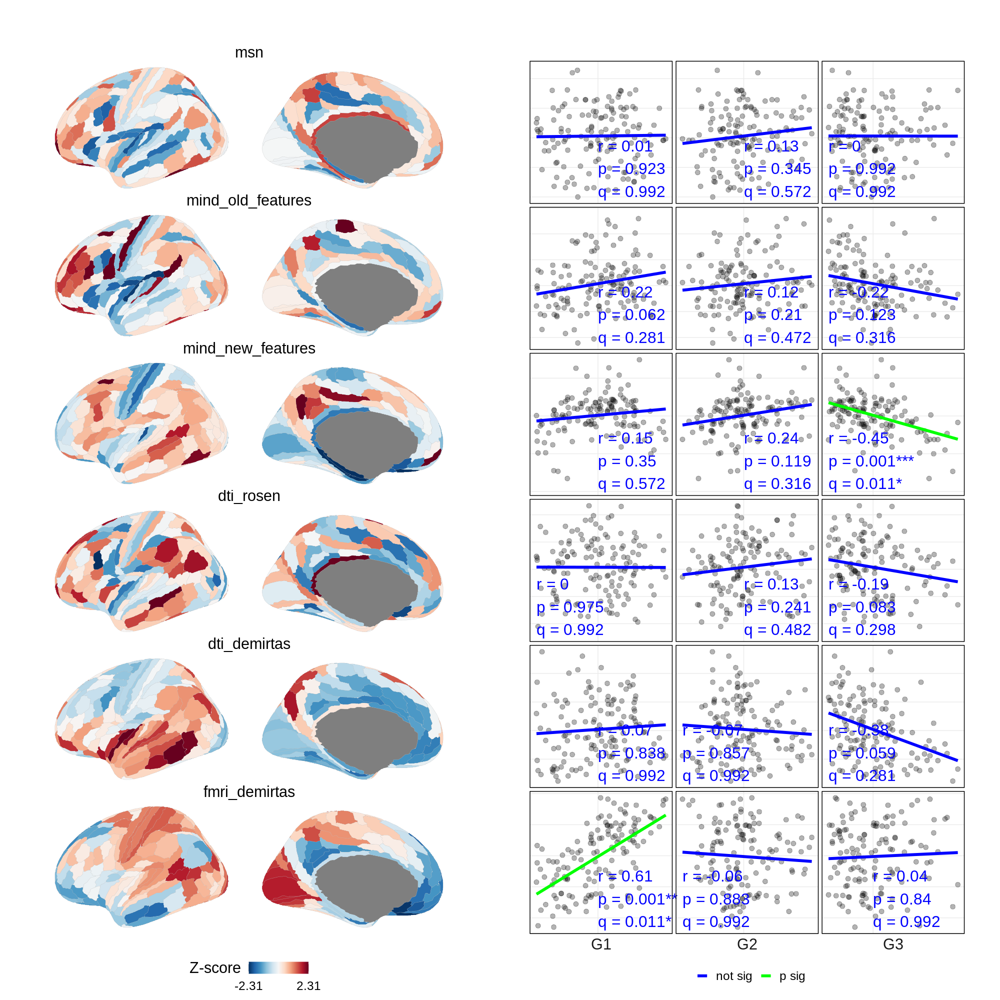

In [1470]:
%%R -i hcp_scores -i maps -i scatter -i null_p -w 20 -h 20 --units in -r 100
source("../code/plot_maps.R")
g0 <- plot_hcp_wide(hcp_scores)
g1 <- plot_maps(maps, ncol=1) + theme(strip.text=element_text(size=22))
g2 <- plot_maps_scatter(scatter, null_p) + theme(text=element_text(size=22), strip.text.y.left=element_blank())
# (g0 / (g1 + g2)) + plot_layout(heights=c(1,4))

g1 + g2

## Module distances

In [1240]:
def edges_by_module(net, modules, how='intra'):
    # Edge matrix of whether nodes are in same module
    same_module = np.subtract.outer(modules, modules)==0
    if how=='intra':
        return np.where(same_module, net, 0)
    elif how=='inter':
        return np.where(~same_module, net, 0)

In [1241]:
hcp_geodesic = np.loadtxt("../data/parcellations/LeftParcelGeodesicDistmat.txt")

In [1477]:
distance = hcp_geodesic

distances_intra = (pd.DataFrame({name:pd.Series(
                (distance * edges_by_module(net, modules[name], how='intra')).sum(0))
                          for name, net in networks.items()})
             .set_index(get_labels_hcp()[:180])
             .apply(lambda x: (x-np.mean(x))/np.std(x))
        )

distances_inter = (pd.DataFrame({name:pd.Series(
                (distance * edges_by_module(net, modules[name], how='inter')).sum(0))
                          for name, net in networks.items()})
             .set_index(get_labels_hcp()[:180])
             .apply(lambda x: (x-np.mean(x))/np.std(x))
        )

maps = pd.concat({
    # 'intra': distances_intra,
    'inter': distances_inter
}, axis=1).droplevel(0, axis=1)
# maps.columns = maps.columns.map(lambda x: '-'.join([str(i) for i in x]))

maps
    

,msn,mind_old_features,mind_new_features,dti_rosen,dti_demirtas,fmri_demirtas
label,,,,,,
V1,1.757860,0.632153,-0.324537,0.781579,-0.173227,3.195573
MST,-0.275443,-0.573838,-0.140502,0.102613,0.378398,0.365248
V6,-0.033049,0.159368,-0.031699,1.131074,-0.544161,1.430651
V2,1.564951,0.768232,0.078606,1.707279,-0.406030,2.969189
V3,1.382791,1.518454,0.786231,1.027347,-0.109060,2.617178
...,...,...,...,...,...,...
STSva,-0.418668,-0.368399,-0.158082,0.030542,1.162826,-0.790272
TE1m,-0.828764,-0.202120,-0.476943,0.751172,1.771989,-0.968697
PI,-1.100574,-1.074284,-1.175421,-0.643032,2.274698,-0.958101


In [1478]:
scatter = (maps
    .melt(ignore_index=False, var_name='map', value_name='map_score')
    .join(hcp_scores.set_index('label'))
    .melt(ignore_index=False, id_vars=['map','map_score'], var_name='G', value_name='G_score')
)

In [1479]:
null_p = (corr_nulls_from_grads(null_scores, hcp_scores, maps, method='pearsonr')
                .join(scatter.groupby(['map','G']).min(), on=('map','G'))
                .rename({'map_score':'y', 'G_score':'x'},axis=1)
)

/opt/conda/lib/python3.10/site-packages/rpy2/robjects/pandas2ri.py:56: UserWarning: DataFrame contains duplicated elements in the index, which will lead to loss of the row names in the resulting data.frame
  warnings.warn('DataFrame contains duplicated elements in the index, '




`geom_smooth()` using formula = 'y ~ x'


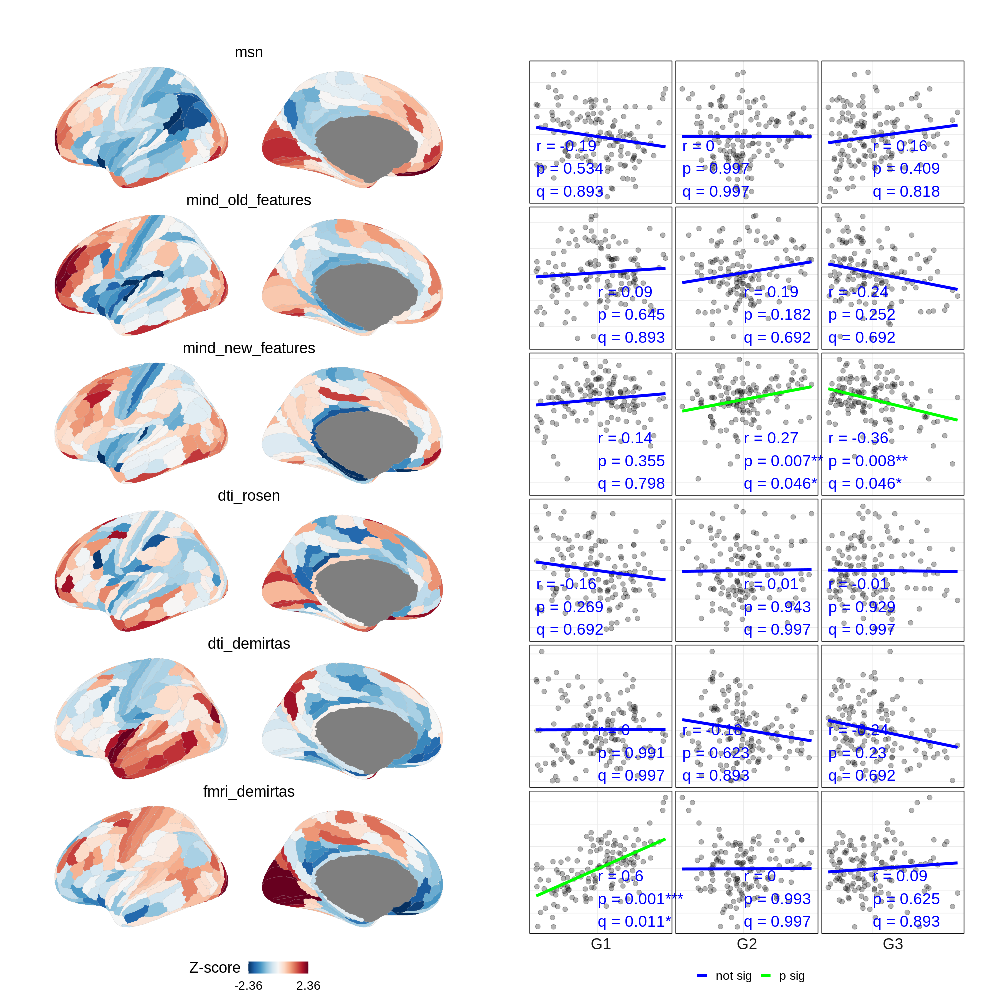

In [1480]:
%%R -i hcp_scores -i maps -i scatter -i null_p -w 20 -h 20 --units in -r 100
source("../code/plot_maps.R")
g0 <- plot_hcp_wide(hcp_scores)
g1 <- plot_maps(maps, ncol=1) & theme(strip.text=element_text(size=22))
g2 <- plot_maps_scatter(scatter, null_p) + theme(text=element_text(size=22), strip.text.y.left=element_blank())
# (g0 / (g1 + g2)) + plot_layout(heights=c(1,4))

g1 + g2

## Participation coef

In [1493]:
participation = (pd.DataFrame({name:pd.Series(bct.participation_coef(net, modules[name])) 
                               for name, net in networks.items()})
                .set_index(get_labels_hcp()[:180])
                .apply(lambda x: (x-np.mean(x))/np.std(x))
)

maps = participation

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.


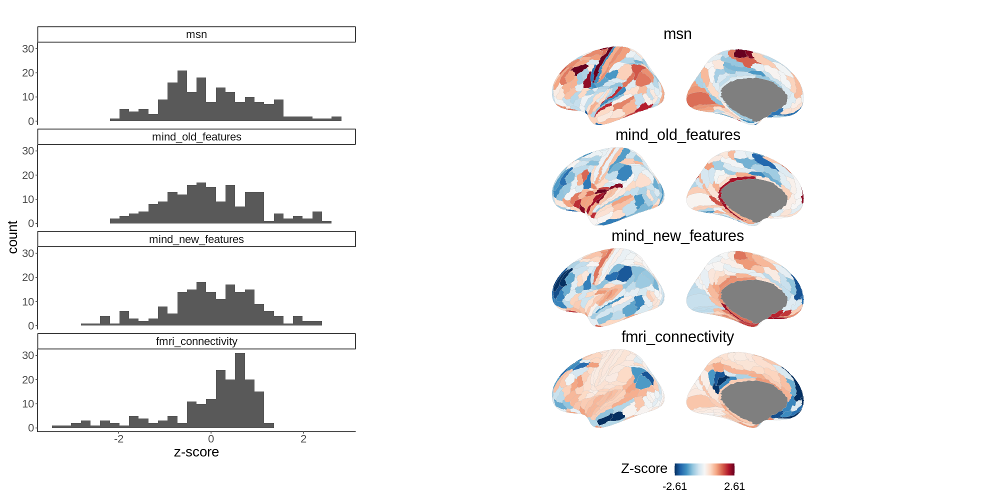

In [705]:
%%R -i maps -w 20 -h 10 -u in -r 100
source("../code/plot_maps.R")
g1 <- maps %>% 
    pivot_longer(everything(), names_to='map') %>% 
    mutate_at(vars(map), ~ factor(., levels=unique(.))) %>% 
    ggplot(aes(value)) + facet_wrap(~map, dir='v', ncol=1) + 
    xlab('z-score') +
    geom_histogram() + theme_classic()

g2 <- plot_maps(maps, ncol=1)

((g1 | g2) + plot_layout(widths=c(1,2))) & 
theme(text=element_text(size=20))

In [1494]:
scatter = (maps
    .melt(ignore_index=False, var_name='map', value_name='map_score')
    .join(hcp_scores.set_index('label'))
    .melt(ignore_index=False, id_vars=['map','map_score'], var_name='G', value_name='G_score')
)

In [1497]:
null_p = (corr_nulls_from_grads(null_scores, hcp_scores, maps, method='pearsonr')
                .join(scatter.groupby(['map','G']).min(), on=('map','G'))
                .rename({'map_score':'y', 'G_score':'x'},axis=1)
)

In [1496]:
maps.corr()

,msn,mind_old_features,mind_new_features,dti_rosen,dti_demirtas,fmri_demirtas
msn,1.000000,0.845935,-0.485487,0.227188,0.167318,-0.117528
mind_old_features,0.845935,1.000000,-0.422448,0.167271,0.006361,-0.141196
mind_new_features,-0.485487,-0.422448,1.000000,-0.306067,-0.244028,0.086050
dti_rosen,0.227188,0.167271,-0.306067,1.000000,0.159981,-0.241508
dti_demirtas,0.167318,0.006361,-0.244028,0.159981,1.000000,-0.093307
fmri_demirtas,-0.117528,-0.141196,0.086050,-0.241508,-0.093307,1.000000


/opt/conda/lib/python3.10/site-packages/rpy2/robjects/pandas2ri.py:56: UserWarning: DataFrame contains duplicated elements in the index, which will lead to loss of the row names in the resulting data.frame
  warnings.warn('DataFrame contains duplicated elements in the index, '




`geom_smooth()` using formula = 'y ~ x'


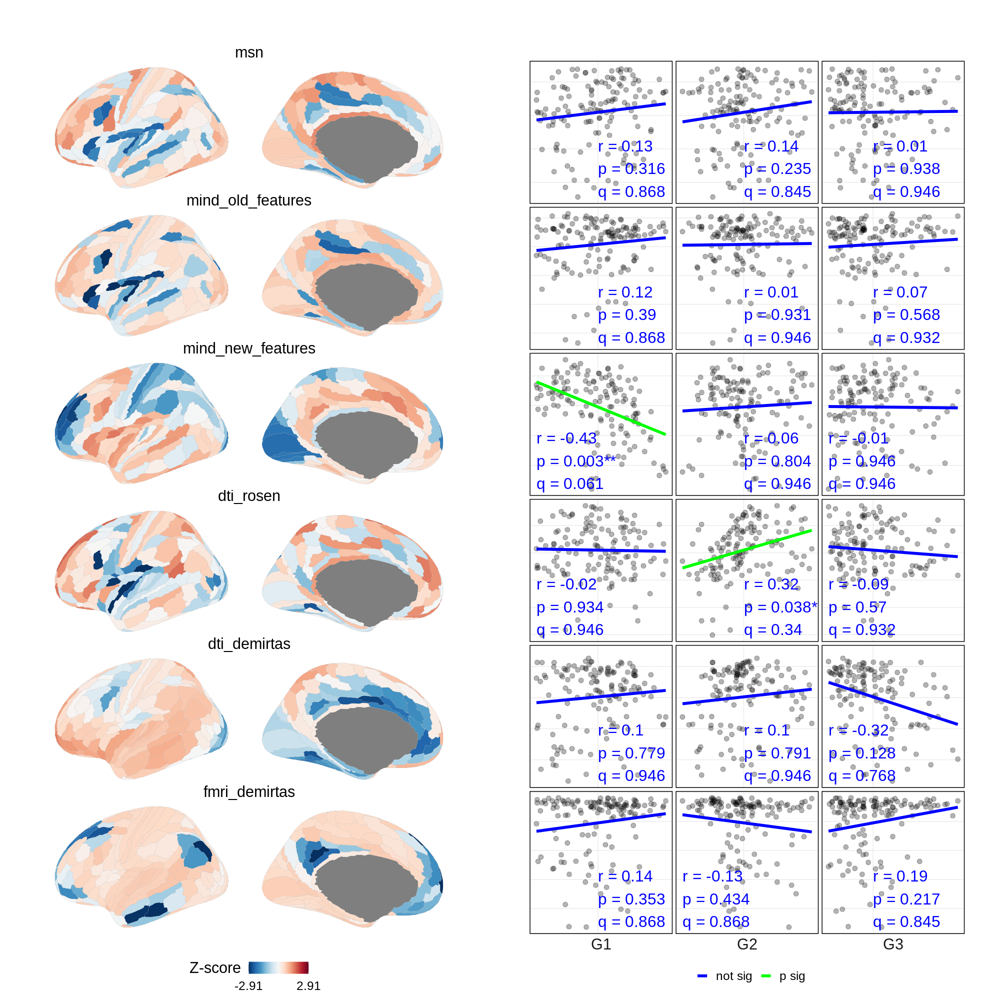

In [1498]:
%%R -i hcp_scores -i maps -i scatter -i null_p -w 20 -h 20 --units in -r 100
source("../code/plot_maps.R")
g0 <- plot_hcp_wide(hcp_scores)
g1 <- plot_maps(maps, ncol=1) & theme(strip.text=element_text(size=22))
g2 <- plot_maps_scatter(scatter, null_p) & theme(text=element_text(size=22), strip.text.y.left=element_blank())
# (g0 / (g1 + g2)) + plot_layout(heights=c(1,4))

g1 + g2

/opt/conda/lib/python3.10/site-packages/rpy2/robjects/pandas2ri.py:56: UserWarning: DataFrame contains duplicated elements in the index, which will lead to loss of the row names in the resulting data.frame
  warnings.warn('DataFrame contains duplicated elements in the index, '




`geom_smooth()` using formula = 'y ~ x'


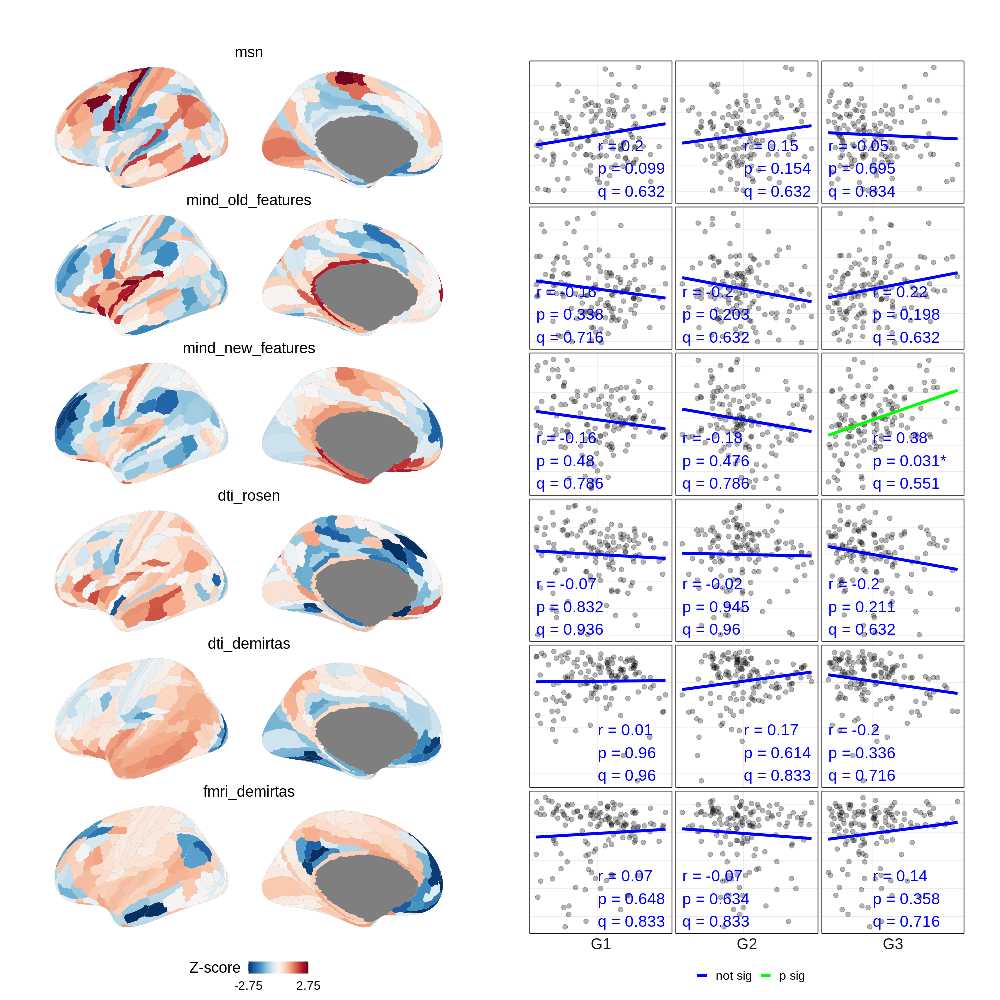

In [ ]:
%%R -i hcp_scores -i maps -i scatter -i null_p -w 20 -h 20 --units in -r 100
source("../code/plot_maps.R")
g0 <- plot_hcp_wide(hcp_scores)
g1 <- plot_maps(maps, ncol=1) & theme(strip.text=element_text(size=22))
g2 <- plot_maps_scatter(scatter, null_p) & theme(text=element_text(size=22), strip.text.y.left=element_blank())
# (g0 / (g1 + g2)) + plot_layout(heights=c(1,4))

g1 + g2

## Betweeness

In [1499]:
betweenness = (pd.DataFrame({name:pd.Series(bct.betweenness_wei(net)) 
                               for name, net in networks.items()})
                .set_index(get_labels_hcp()[:180])
                .apply(lambda x: (x-np.mean(x))/np.std(x))
)

maps = betweenness

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.


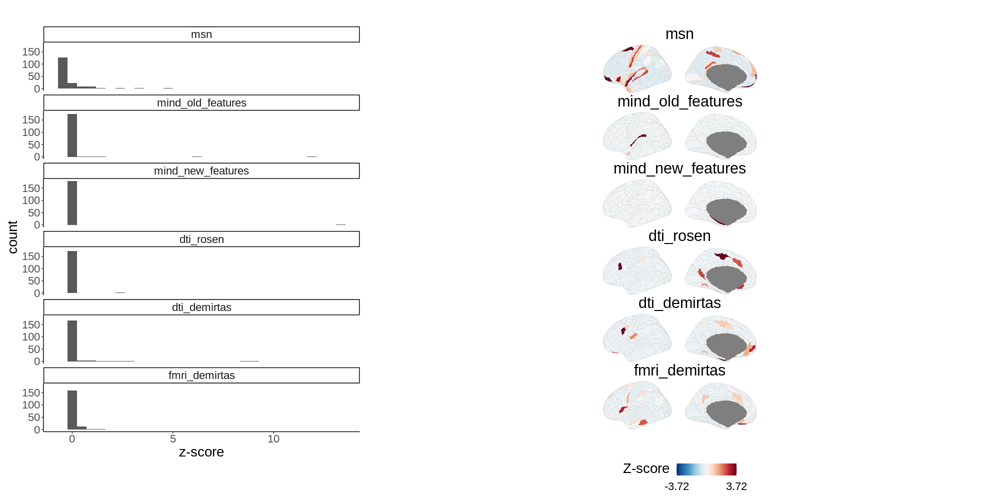

In [1500]:
%%R -i maps -w 20 -h 10 -u in -r 100
source("../code/plot_maps.R")
g1 <- maps %>% 
    pivot_longer(everything(), names_to='map') %>% 
    mutate_at(vars(map), ~ factor(., levels=unique(.))) %>% 
    ggplot(aes(value)) + facet_wrap(~map, dir='v', ncol=1) + 
    xlab('z-score') +
    geom_histogram() + theme_classic()

g2 <- plot_maps(maps, ncol=1)

((g1 | g2) + plot_layout(widths=c(1,2))) & 
theme(text=element_text(size=20))

In [ ]:
scatter = (maps
    .melt(ignore_index=False, var_name='map', value_name='map_score')
    .join(hcp_scores.set_index('label'))
    .melt(ignore_index=False, id_vars=['map','map_score'], var_name='G', value_name='G_score')
)

In [ ]:
null_p = (corr_nulls_from_grads(null_scores, hcp_scores, maps, method='pearsonr')
                .join(scatter.groupby(['map','G']).min(), on=('map','G'))
                .rename({'map_score':'y', 'G_score':'x'},axis=1)
)

In [ ]:
maps.corr()

,msn,mind_old_features,mind_new_features,fmri_connectivity
msn,1.000000,-0.325357,-0.190311,-0.042790
mind_old_features,-0.325357,1.000000,0.305364,0.013747
mind_new_features,-0.190311,0.305364,1.000000,0.222082
fmri_connectivity,-0.042790,0.013747,0.222082,1.000000


/opt/conda/lib/python3.10/site-packages/rpy2/robjects/pandas2ri.py:56: UserWarning: DataFrame contains duplicated elements in the index, which will lead to loss of the row names in the resulting data.frame
  warnings.warn('DataFrame contains duplicated elements in the index, '




`geom_smooth()` using formula = 'y ~ x'


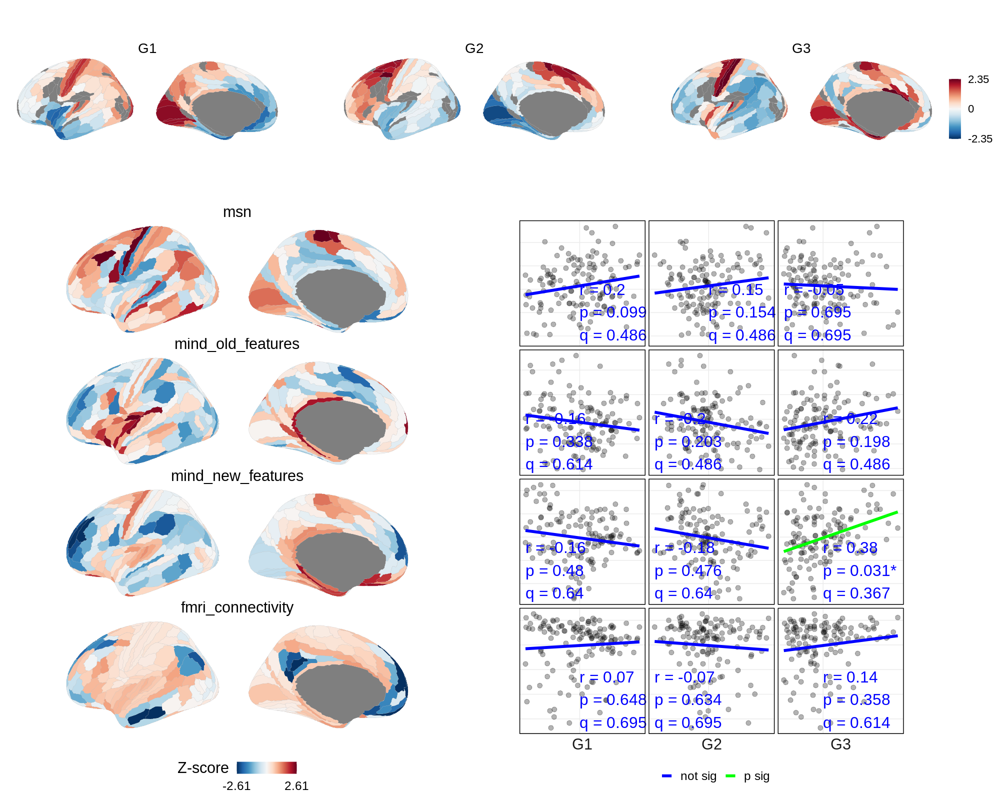

In [ ]:
%%R -i hcp_scores -i maps -i scatter -i null_p -w 20 -h 16 --units in -r 100
source("../code/plot_maps.R")
g0 <- plot_hcp_wide(hcp_scores)
g1 <- plot_maps(maps, ncol=1) & theme(strip.text=element_text(size=22))
g2 <- plot_maps_scatter(scatter, null_p) & theme(text=element_text(size=22), strip.text.y.left=element_blank())
(g0 / (g1 + g2)) + plot_layout(heights=c(1,4))

## Eigenvector centrality

In [1588]:
centrality = (pd.DataFrame({name:pd.Series(bct.eigenvector_centrality_und(net))
                               for name, net in networks.items()})
                .set_index(get_labels_hcp()[:180])
                .apply(lambda x: (x-np.mean(x))/np.std(x))
)

maps = centrality

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.


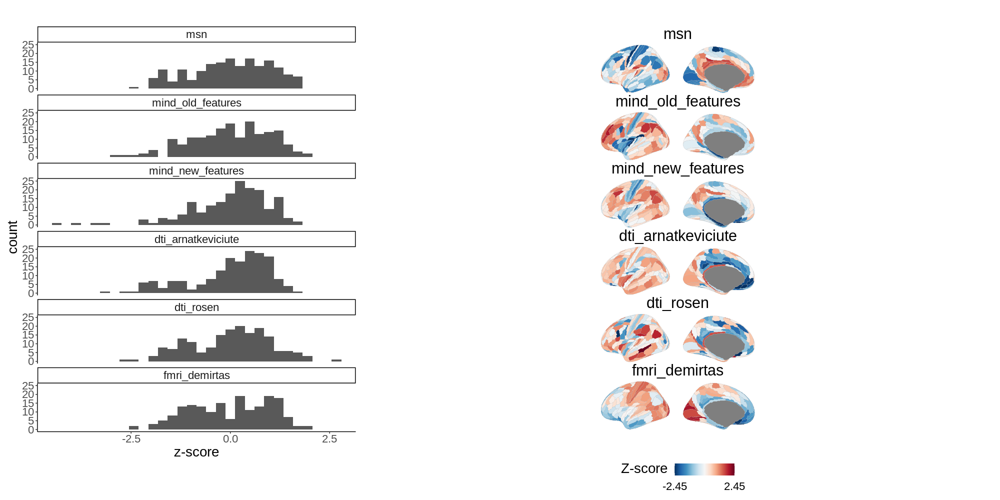

In [1589]:
%%R -i maps -w 20 -h 10 -u in -r 100
source("../code/plot_maps.R")
g1 <- maps %>% 
    pivot_longer(everything(), names_to='map') %>% 
    mutate_at(vars(map), ~ factor(., levels=unique(.))) %>% 
    ggplot(aes(value)) + facet_wrap(~map, dir='v', ncol=1) + 
    xlab('z-score') +
    geom_histogram() + theme_classic()

g2 <- plot_maps(maps, ncol=1)

((g1 | g2) + plot_layout(widths=c(1,2))) & 
theme(text=element_text(size=20))

In [1590]:
scatter = (maps
    .melt(ignore_index=False, var_name='map', value_name='map_score')
    .join(hcp_scores.set_index('label'))
    .melt(ignore_index=False, id_vars=['map','map_score'], var_name='G', value_name='G_score')
)

In [1591]:
null_p = (corr_nulls_from_grads(null_scores, hcp_scores, maps, method='pearsonr')
                .join(scatter.groupby(['map','G']).min(), on=('map','G'))
                .rename({'map_score':'y', 'G_score':'x'},axis=1)
)

In [1592]:
maps.corr()

,msn,mind_old_features,mind_new_features,dti_arnatkeviciute,dti_rosen,fmri_demirtas
msn,1.000000,-0.311460,-0.087537,-0.498319,-0.203993,-0.187728
mind_old_features,-0.311460,1.000000,0.544149,0.224368,0.189788,0.098621
mind_new_features,-0.087537,0.544149,1.000000,0.158013,0.089845,0.350739
dti_arnatkeviciute,-0.498319,0.224368,0.158013,1.000000,0.423098,0.307933
dti_rosen,-0.203993,0.189788,0.089845,0.423098,1.000000,0.023656
fmri_demirtas,-0.187728,0.098621,0.350739,0.307933,0.023656,1.000000


/opt/conda/lib/python3.10/site-packages/rpy2/robjects/pandas2ri.py:56: UserWarning: DataFrame contains duplicated elements in the index, which will lead to loss of the row names in the resulting data.frame
  warnings.warn('DataFrame contains duplicated elements in the index, '




`geom_smooth()` using formula = 'y ~ x'


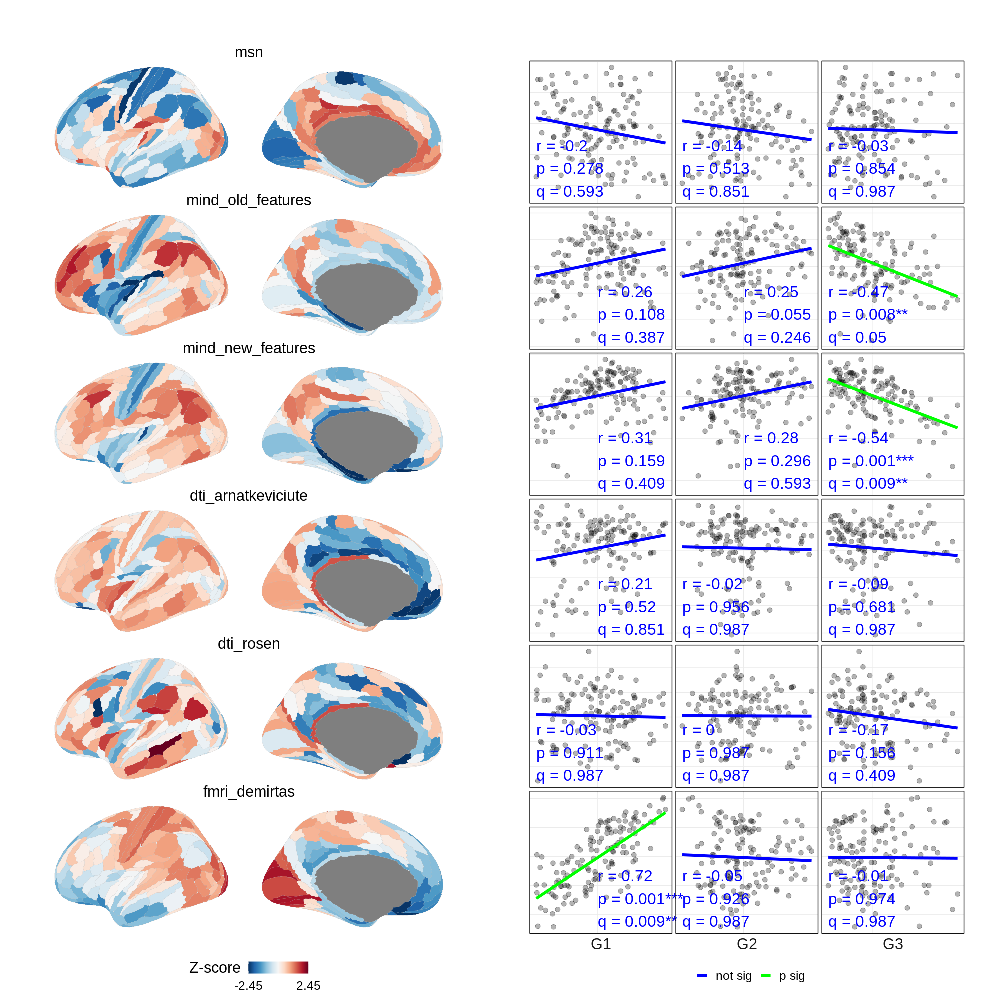

In [1593]:
%%R -i hcp_scores -i maps -i scatter -i null_p -w 20 -h 20 --units in -r 100
source("../code/plot_maps.R")
g0 <- plot_hcp_wide(hcp_scores)
g1 <- plot_maps(maps, ncol=1) & theme(strip.text=element_text(size=22))
g2 <- plot_maps_scatter(scatter, null_p) & theme(text=element_text(size=22), strip.text.y.left=element_blank())
# (g0 / (g1 + g2)) + plot_layout(heights=c(1,4))
g1 + g2

## Clustering coef

In [1594]:
clustering = (pd.DataFrame({name:pd.Series(bct.clustering_coef_wu(net))
                               for name, net in networks.items()})
                .set_index(get_labels_hcp()[:180])
                .apply(lambda x: (x-np.mean(x))/np.std(x))
)

maps = clustering

`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.


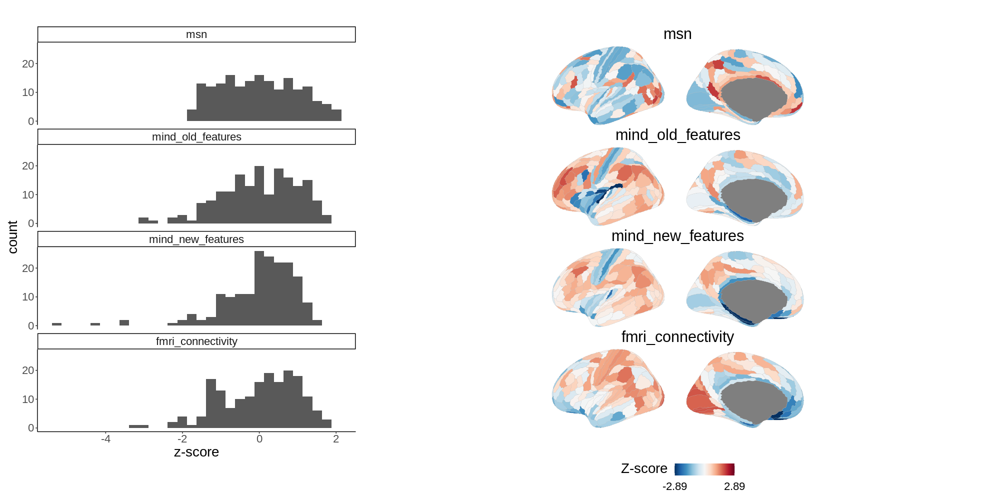

In [739]:
%%R -i maps -w 20 -h 10 -u in -r 100
source("../code/plot_maps.R")
g1 <- maps %>% 
    pivot_longer(everything(), names_to='map') %>% 
    mutate_at(vars(map), ~ factor(., levels=unique(.))) %>% 
    ggplot(aes(value)) + facet_wrap(~map, dir='v', ncol=1) + 
    xlab('z-score') +
    geom_histogram() + theme_classic()

g2 <- plot_maps(maps, ncol=1)

((g1 | g2) + plot_layout(widths=c(1,2))) & 
theme(text=element_text(size=20))

In [1595]:
scatter = (maps
    .melt(ignore_index=False, var_name='map', value_name='map_score')
    .join(hcp_scores.set_index('label'))
    .melt(ignore_index=False, id_vars=['map','map_score'], var_name='G', value_name='G_score')
)

In [1596]:
null_p = (corr_nulls_from_grads(null_scores, hcp_scores, maps, method='pearsonr')
                .join(scatter.groupby(['map','G']).min(), on=('map','G'))
                .rename({'map_score':'y', 'G_score':'x'},axis=1)
)

In [1597]:
maps.corr()

,msn,mind_old_features,mind_new_features,dti_arnatkeviciute,dti_rosen,fmri_demirtas
msn,1.000000,0.168815,0.020415,-0.312566,-0.170853,-0.108940
mind_old_features,0.168815,1.000000,0.514656,0.206974,0.182870,0.141659
mind_new_features,0.020415,0.514656,1.000000,0.120816,0.053053,0.421793
dti_arnatkeviciute,-0.312566,0.206974,0.120816,1.000000,0.408553,0.315030
dti_rosen,-0.170853,0.182870,0.053053,0.408553,1.000000,0.044433
fmri_demirtas,-0.108940,0.141659,0.421793,0.315030,0.044433,1.000000


/opt/conda/lib/python3.10/site-packages/rpy2/robjects/pandas2ri.py:56: UserWarning: DataFrame contains duplicated elements in the index, which will lead to loss of the row names in the resulting data.frame
  warnings.warn('DataFrame contains duplicated elements in the index, '




`geom_smooth()` using formula = 'y ~ x'


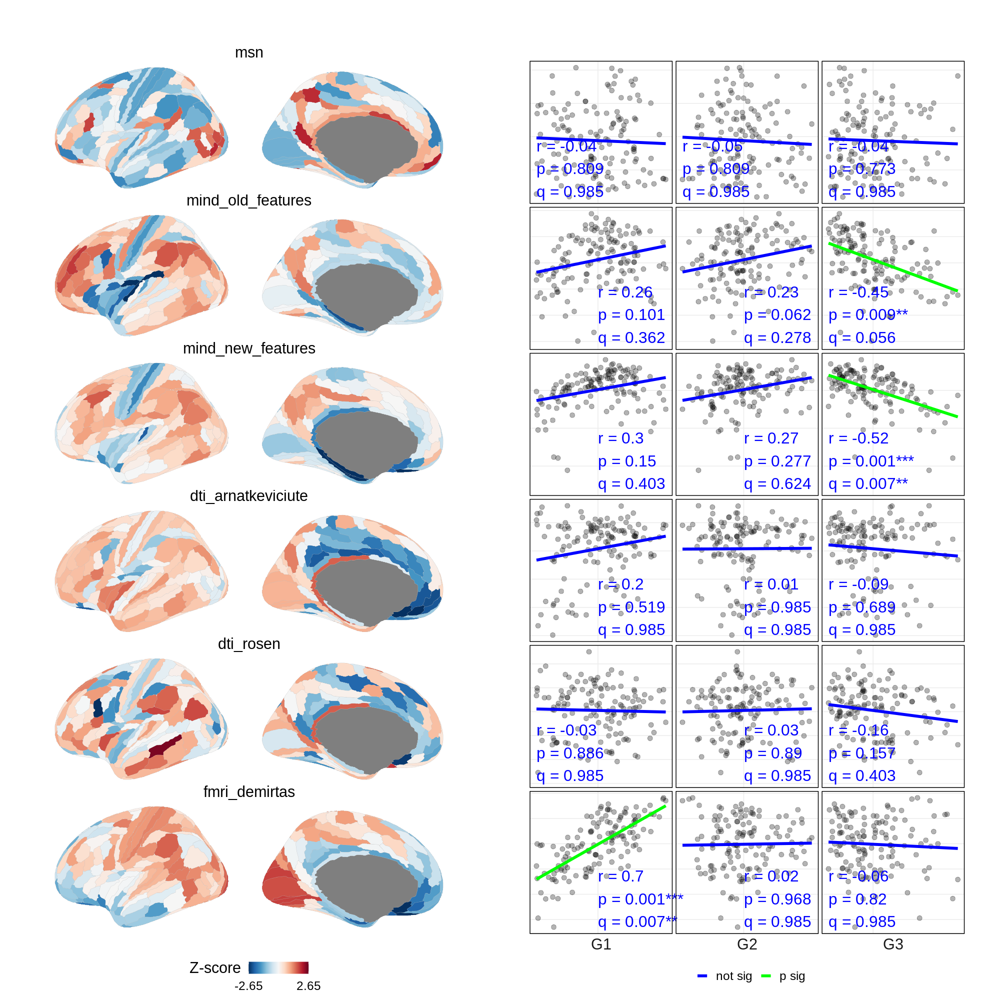

In [1598]:
%%R -i hcp_scores -i maps -i scatter -i null_p -w 20 -h 20 --units in -r 100
source("../code/plot_maps.R")
g0 <- plot_hcp_wide(hcp_scores)
g1 <- plot_maps(maps, ncol=1) & theme(strip.text=element_text(size=22))
g2 <- plot_maps_scatter(scatter, null_p) & theme(text=element_text(size=22), strip.text.y.left=element_blank())
# (g0 / (g1 + g2)) + plot_layout(heights=c(1,4))

g1 + g2

## Path length

In [797]:
net = networks['mind_old_features']
bct.distance_wei(1/net)[0].sum(0)

/tmp/ipykernel_55371/2592204634.py:2: RuntimeWarning: divide by zero encountered in true_divide
  bct.distance_wei(1/net)[0].sum(0)


array([1649.31411463, 1762.38123014, 1589.63337205, 1633.06483926,
       1466.60513505, 1360.46606357, 1400.07158165, 1325.45455001,
       2044.11647043, 1412.10536419, 1492.69396498, 1530.59029288,
       1659.01724508, 1790.82661377, 1361.35796468, 1601.73316601,
       1643.5813153 , 1345.29801395, 1967.89704739, 1487.41363763,
       1621.69051257, 1677.72388899, 1458.73769581, 1971.25301075,
       1348.18660265, 1814.59616472, 1382.2049675 , 1514.42468254,
       1719.81828204, 1391.17464724, 1298.41457721, 1787.1447806 ,
       1611.57550246, 1813.51145516, 1620.40029239, 1857.07525857,
       1896.20329902, 1744.27304477, 1813.2816065 , 1426.87076033,
       1760.88227369, 1719.12519556, 1481.19367738, 1488.24468036,
       1662.40893783, 1901.35070636, 1596.14777269, 1533.02148265,
       1718.88818685, 1591.5525885 , 1934.45139414, 1459.17557562,
       1950.16638314, 1617.28486996, 1508.47698673, 1943.80169997,
       1624.94540611, 1932.64555797, 1716.55477137, 1891.13073

In [1599]:
path_length = (pd.DataFrame({name:pd.Series(bct.distance_wei(1/net)[0].sum(0))
                               for name, net in networks.items()})
                .set_index(get_labels_hcp()[:180])
                .apply(lambda x: (x-np.mean(x))/np.std(x))
)

maps = path_length

/tmp/ipykernel_55371/282114286.py:1: RuntimeWarning: divide by zero encountered in true_divide
  path_length = (pd.DataFrame({name:pd.Series(bct.distance_wei(1/net)[0].sum(0))


`stat_bin()` using `bins = 30`. Pick better value with `binwidth`.


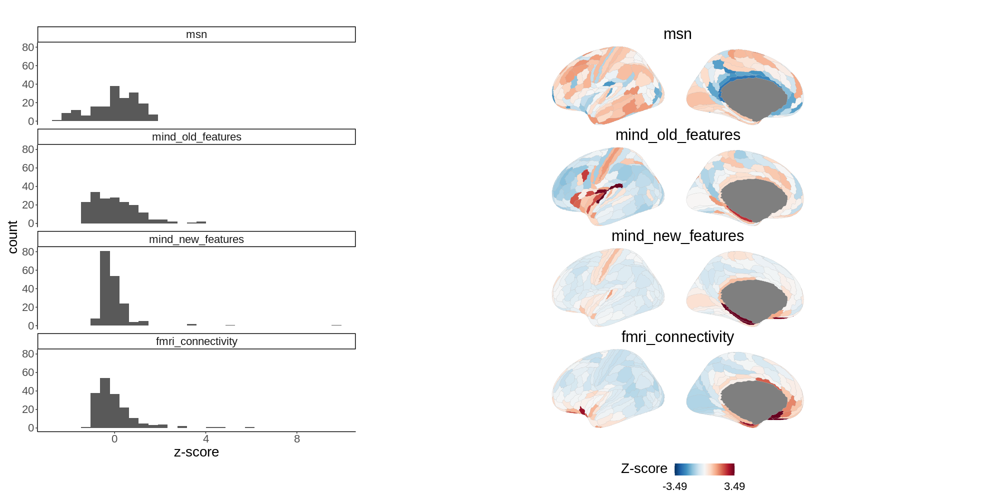

In [872]:
%%R -i maps -w 20 -h 10 -u in -r 100
source("../code/plot_maps.R")
g1 <- maps %>% 
    pivot_longer(everything(), names_to='map') %>% 
    mutate_at(vars(map), ~ factor(., levels=unique(.))) %>% 
    ggplot(aes(value)) + facet_wrap(~map, dir='v', ncol=1) + 
    xlab('z-score') +
    geom_histogram() + theme_classic()

g2 <- plot_maps(maps, ncol=1)

((g1 | g2) + plot_layout(widths=c(1,2))) & 
theme(text=element_text(size=20))

In [1600]:
scatter = (maps
    .melt(ignore_index=False, var_name='map', value_name='map_score')
    .join(hcp_scores.set_index('label'))
    .melt(ignore_index=False, id_vars=['map','map_score'], var_name='G', value_name='G_score')
)

In [1601]:
null_p = (corr_nulls_from_grads(null_scores, hcp_scores, maps, method='pearsonr')
                .join(scatter.groupby(['map','G']).min(), on=('map','G'))
                .rename({'map_score':'y', 'G_score':'x'},axis=1)
)

In [1602]:
maps.corr()

,msn,mind_old_features,mind_new_features,dti_arnatkeviciute,dti_rosen,fmri_demirtas
msn,1.000000,-0.157040,-0.047699,-0.313134,-0.124481,-0.259414
mind_old_features,-0.157040,1.000000,0.377824,0.146729,0.170221,0.221568
mind_new_features,-0.047699,0.377824,1.000000,0.075207,0.051800,0.456043
dti_arnatkeviciute,-0.313134,0.146729,0.075207,1.000000,0.374302,0.377672
dti_rosen,-0.124481,0.170221,0.051800,0.374302,1.000000,0.073440
fmri_demirtas,-0.259414,0.221568,0.456043,0.377672,0.073440,1.000000


/opt/conda/lib/python3.10/site-packages/rpy2/robjects/pandas2ri.py:56: UserWarning: DataFrame contains duplicated elements in the index, which will lead to loss of the row names in the resulting data.frame
  warnings.warn('DataFrame contains duplicated elements in the index, '




`geom_smooth()` using formula = 'y ~ x'


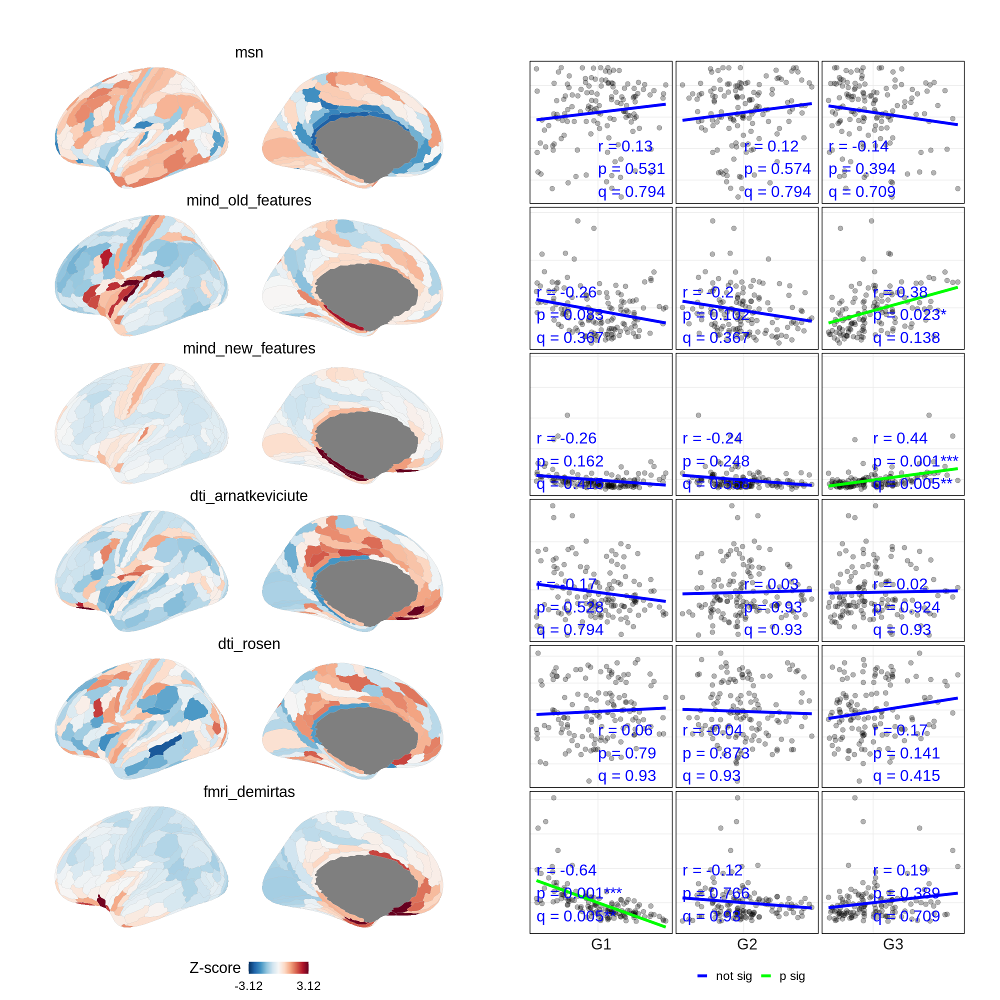

In [1603]:
%%R -i hcp_scores -i maps -i scatter -i null_p -w 20 -h 20 --units in -r 100
source("../code/plot_maps.R")
g0 <- plot_hcp_wide(hcp_scores)
g1 <- plot_maps(maps, ncol=1) & theme(strip.text=element_text(size=22))
g2 <- plot_maps_scatter(scatter, null_p) & theme(text=element_text(size=22), strip.text.y.left=element_blank())
# (g0 / (g1 + g2)) + plot_layout(heights=c(1,4))

g1 + g2

## Module distances only (no weights)

In [678]:
blank_network = {'blank': np.ones([180,180])}
modules['blank'] = modules['mind_new_features']

In [679]:
distance = hcp_geodesic

distances_intra = (pd.DataFrame({name:pd.Series(
                (distance * edges_by_module(net, modules[name], how='intra')).sum(0))
                          for name, net in blank_network.items()})
             .set_index(get_labels_hcp()[:180])
             .apply(lambda x: (x-np.mean(x))/np.std(x))
        )

distances_inter = (pd.DataFrame({name:pd.Series(
                (distance * edges_by_module(net, modules[name], how='inter')).sum(0))
                          for name, net in blank_network.items()})
             .set_index(get_labels_hcp()[:180])
             .apply(lambda x: (x-np.mean(x))/np.std(x))
        )

maps = pd.concat({
    'intra': distances_intra,
    'inter': distances_inter
}, axis=1)
maps.columns = maps.columns.map(lambda x: '-'.join([str(i) for i in x]))

maps

,intra-blank,inter-blank
label,,
V1,-0.053346,1.654381
MST,-1.288103,0.395441
V6,-0.934833,1.104846
V2,-0.159636,1.476343
V3,-0.343631,1.393380
...,...,...
STSva,-1.313254,1.297990
TE1m,-0.100974,0.598305
PI,-1.548216,0.215571


In [680]:
scatter = (maps
    .melt(ignore_index=False, var_name='map', value_name='map_score')
    .join(hcp_scores.set_index('label'))
    .melt(ignore_index=False, id_vars=['map','map_score'], var_name='G', value_name='G_score')
)

In [681]:
null_p = (corr_nulls_from_grads(null_scores, hcp_scores, maps, method='pearsonr')
                .join(scatter.groupby(['map','G']).min(), on=('map','G'))
                .rename({'map_score':'y', 'G_score':'x'},axis=1)
)

/opt/conda/lib/python3.10/site-packages/rpy2/robjects/pandas2ri.py:56: UserWarning: DataFrame contains duplicated elements in the index, which will lead to loss of the row names in the resulting data.frame
  warnings.warn('DataFrame contains duplicated elements in the index, '




`geom_smooth()` using formula = 'y ~ x'


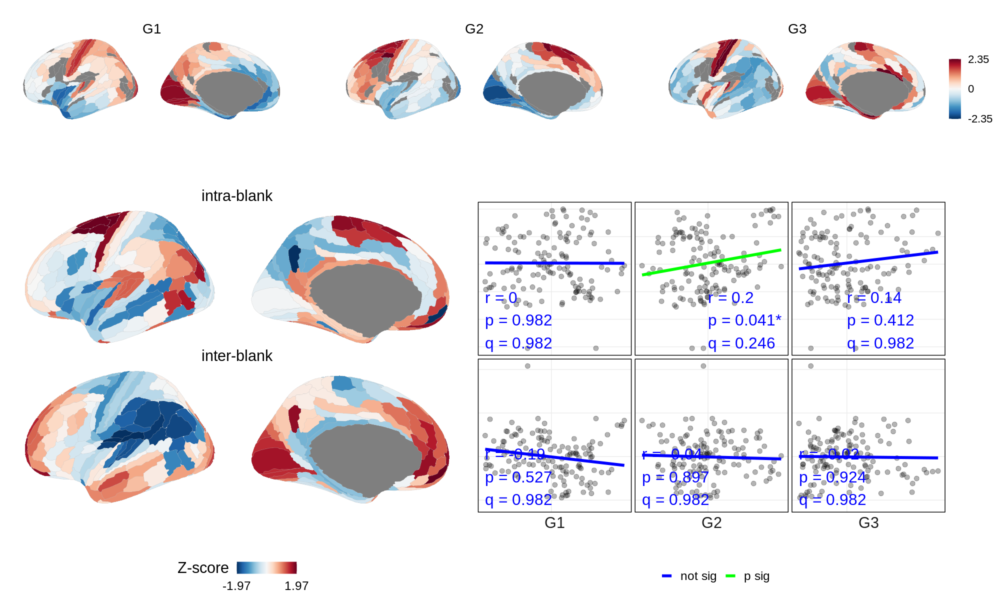

In [682]:
%%R -i hcp_scores -i maps -i scatter -i null_p -w 20 -h 12 --units in -r 100
source("../code/plot_maps.R")
g0 <- plot_hcp_wide(hcp_scores)
g1 <- plot_maps(maps, ncol=1) & theme(strip.text=element_text(size=22))
g2 <- plot_maps_scatter(scatter, null_p) & theme(text=element_text(size=22), strip.text.y.left=element_blank())
(g0 / (g1 + g2)) + plot_layout(heights=c(1,4))

## Binary networks

https://www.pnas.org/doi/10.1073/pnas.2013232118

In [1643]:
networks_bin = {
    'msn': pd.read_csv("../data/MeanMSN.HCP.CT_MC_SA_SD_Vol.csv", index_col=0).values[:180,:180]/2+.5,
    'mind_old_features': pd.read_csv("../data/MeanMIND.HCP.CT_MC_SA_SD_Vol.csv", index_col=0).values[:180,:180],
    'mind_new_features': pd.read_csv("../data/MeanMIND.HCP.CT_MC_MD_ICVF.not_normalized.csv", index_col=0).values[:180,:180],
    'dti_demirtas': nib.load("../data/average_sc.pconn.nii").get_fdata()[:180,:180],
    # 'dti_arnatkeviciute': pd.read_csv("../data/MeanDTI_arnatkeceviute.csv", index_col=0).values[:180,:180],
    # 'dti_enigma': pd.read_csv("../data/MeanDTI_enigma_toolbox.csv", index_col=0).values[:180,:180],
    # 'dti_prob_trac': pd.read_csv("../data/MeanDTI_prob_trac.csv", index_col=0).values[:180,:180],
    'dti_rosen': pd.read_csv("../data/averageConnectivity_Fpt.csv", index_col=0).values[:180,:180],
    # 'dti_demirtas': nib.load("../data/average_sc.pconn.nii").get_fdata()[:180,:180],
    'fmri_demirtas': nib.load("../data/average_fc.pconn.nii").get_fdata()[:180,:180],
}

for net in networks.values():
    np.fill_diagonal(net,np.nan)

# Rosen has NAs on diagonal
# np.fill_diagonal(networks_bin['dti_rosen'],-100)
# prob trac has nonzero values on diagonal
# np.fill_diagonal(networks_bin['dti_prob_trac'],-100)

# np.fill_diagonal(networks_bin['fmri_connectivity'],0)

networks_bin = {name:np.where(net > np.nanquantile(net, .70), 1, 0)
                for name, net in networks_bin.items()}

for net in networks_bin.values():
    np.fill_diagonal(net, 0)

In [1644]:
networks_bin['dti_demirtas'].sum()

9720

In [1645]:
yeo = pd.read_csv("../data/mesulam_ve_yeo.csv", index_col=0)['Yeo'].values
modules = {name:yeo for name,net in networks_bin.items()}

In [1625]:
networks_sorted = {name:net[modules[name].argsort(),:][:,modules[name].argsort()]
                   for name, net in networks_bin.items()}

In [1626]:
networks_df = (pd.DataFrame({name:net.flatten() for name, net in networks_sorted.items()}, 
                index=pd.MultiIndex.from_product([range(180),range(180)], names=['x','y']))
                # .apply(lambda x: x/np.std(x))
                # .apply(lambda x: (x-np.mean(x))/np.std(x))
                # .apply(lambda x: x.clip(upper=np.quantile(x,.99), lower=np.quantile(x,.01)))
                )
networks_df_plot = (networks_df
                    # .apply(lambda x: x/np.std(x))
                    # .apply(lambda x: x.clip(upper=np.quantile(x,.95), lower=None))#np.quantile(x,.05)))
                    # .apply(lambda x: (x-np.mean(x))/np.std(x))
                    .reset_index()
)

networks_df_plot.describe()

,x,y,msn,mind_old_features,mind_new_features,dti_demirtas,dti_rosen,fmri_demirtas
count,32400.000000,32400.000000,32400.000000,32400.000000,32400.000000,32400.000000,32400.000000,32400.000000
mean,89.500000,89.500000,0.294444,0.300000,0.300000,0.300000,0.298333,0.294444
std,51.961524,51.961524,0.455800,0.458265,0.458265,0.458265,0.457534,0.455800
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,44.750000,44.750000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,89.500000,89.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,134.250000,134.250000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
max,179.000000,179.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [1627]:
networks_df.corr()

,msn,mind_old_features,mind_new_features,dti_demirtas,dti_rosen,fmri_demirtas
msn,1.000000,0.292875,0.195644,0.033100,0.029290,0.046501
mind_old_features,0.292875,1.000000,0.405938,0.074074,0.072161,0.109939
mind_new_features,0.195644,0.405938,1.000000,0.153733,0.073633,0.231403
dti_demirtas,0.033100,0.074074,0.153733,1.000000,0.247043,0.231403
dti_rosen,0.029290,0.072161,0.073633,0.247043,1.000000,0.089379
fmri_demirtas,0.046501,0.109939,0.231403,0.231403,0.089379,1.000000


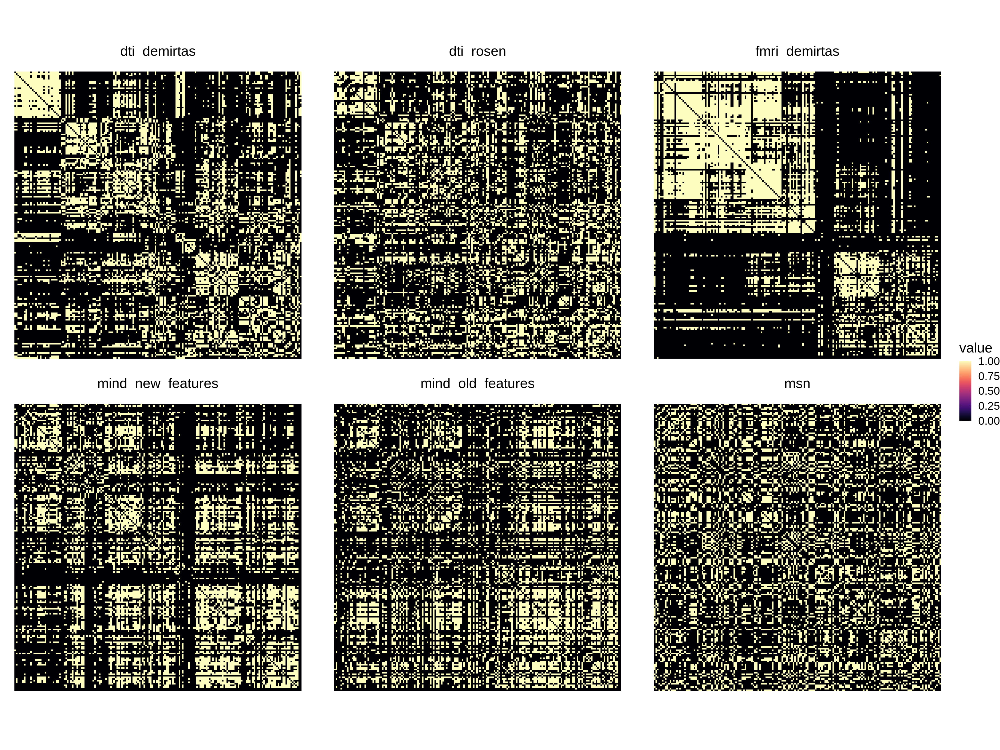

In [1628]:
%%R -i networks_df_plot -w 20 -h 15 -u in -r 200
networks_df_plot %>% 
# select(x,y,dti_prob_trac,dti_rosen) %>% 
pivot_longer(-c('x','y'), names_to='network', values_to='value') %>% 
ggplot(aes(x,y,fill=value)) +
facet_wrap(~network) +
geom_raster() + 
scale_fill_gradientn(colors=magma(100)) +
scale_y_reverse() +
theme_void() + 
theme(
    text=element_text(size=20),
    strip.text=element_text(size=20),
    aspect.ratio=1
    )

## Thresholded strengths

In [1579]:
strengths = (pd.DataFrame({name:pd.Series(net.sum(0)) 
                          for name, net in networks_bin.items()})
             .set_index(get_labels_hcp()[:180])
             .apply(lambda x: (x-np.mean(x))/np.std(x))
        )

maps = strengths

In [1580]:
scatter = (maps
    .melt(ignore_index=False, var_name='map', value_name='map_score')
    .join(hcp_scores.set_index('label'))
    .melt(ignore_index=False, id_vars=['map','map_score'], var_name='G', value_name='G_score')
)

In [1581]:
null_p = (corr_nulls_from_grads(null_scores, hcp_scores, maps, method='pearsonr')
                .join(scatter.groupby(['map','G']).min(), on=('map','G'))
                .rename({'map_score':'y', 'G_score':'x'},axis=1)
)

/opt/conda/lib/python3.10/site-packages/rpy2/robjects/pandas2ri.py:56: UserWarning: DataFrame contains duplicated elements in the index, which will lead to loss of the row names in the resulting data.frame
  warnings.warn('DataFrame contains duplicated elements in the index, '




`geom_smooth()` using formula = 'y ~ x'


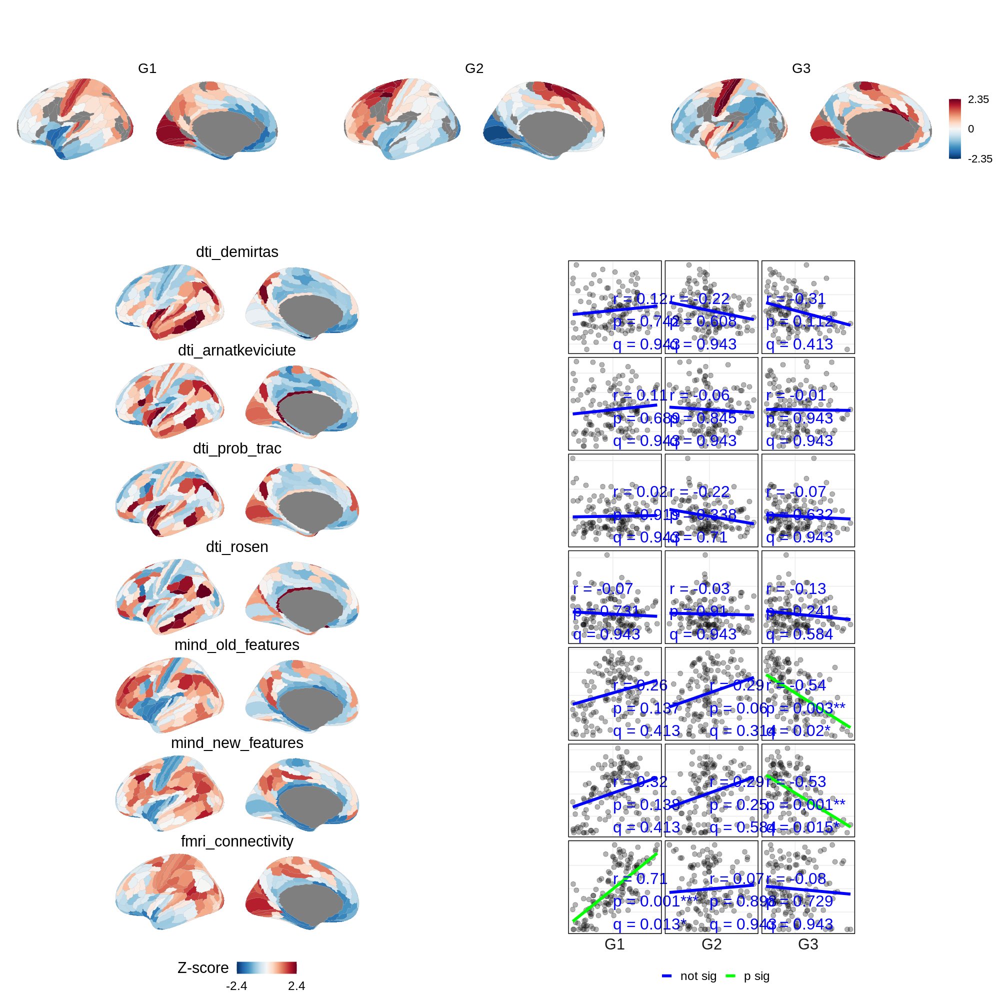

In [1582]:
%%R -i hcp_scores -i maps -i scatter -i null_p -w 20 -h 20 --units in -r 100
source("../code/plot_maps.R")
g0 <- plot_hcp_wide(hcp_scores)
g1 <- plot_maps(maps, ncol=1) & theme(strip.text=element_text(size=22))
g2 <- plot_maps_scatter(scatter, null_p) & theme(text=element_text(size=22), strip.text.y.left=element_blank())
(g0 / (g1 + g2)) + plot_layout(heights=c(1,4))

## Thresholded distances

In [1638]:
distances = (pd.DataFrame({name:pd.Series((hcp_geodesic * net).sum(0)) 
                          for name, net in networks_bin.items()})
             .set_index(get_labels_hcp()[:180])
             .apply(lambda x: (x-np.mean(x))/np.std(x))
        )

maps = distances

In [1639]:
scatter = (maps
    .melt(ignore_index=False, var_name='map', value_name='map_score')
    .join(hcp_scores.set_index('label'))
    .melt(ignore_index=False, id_vars=['map','map_score'], var_name='G', value_name='G_score')
)

In [1640]:
null_p = (corr_nulls_from_grads(null_scores, hcp_scores, maps, method='pearsonr')
                .join(scatter.groupby(['map','G']).min(), on=('map','G'))
                .rename({'map_score':'y', 'G_score':'x'},axis=1)
)

/opt/conda/lib/python3.10/site-packages/rpy2/robjects/pandas2ri.py:56: UserWarning: DataFrame contains duplicated elements in the index, which will lead to loss of the row names in the resulting data.frame
  warnings.warn('DataFrame contains duplicated elements in the index, '




`geom_smooth()` using formula = 'y ~ x'


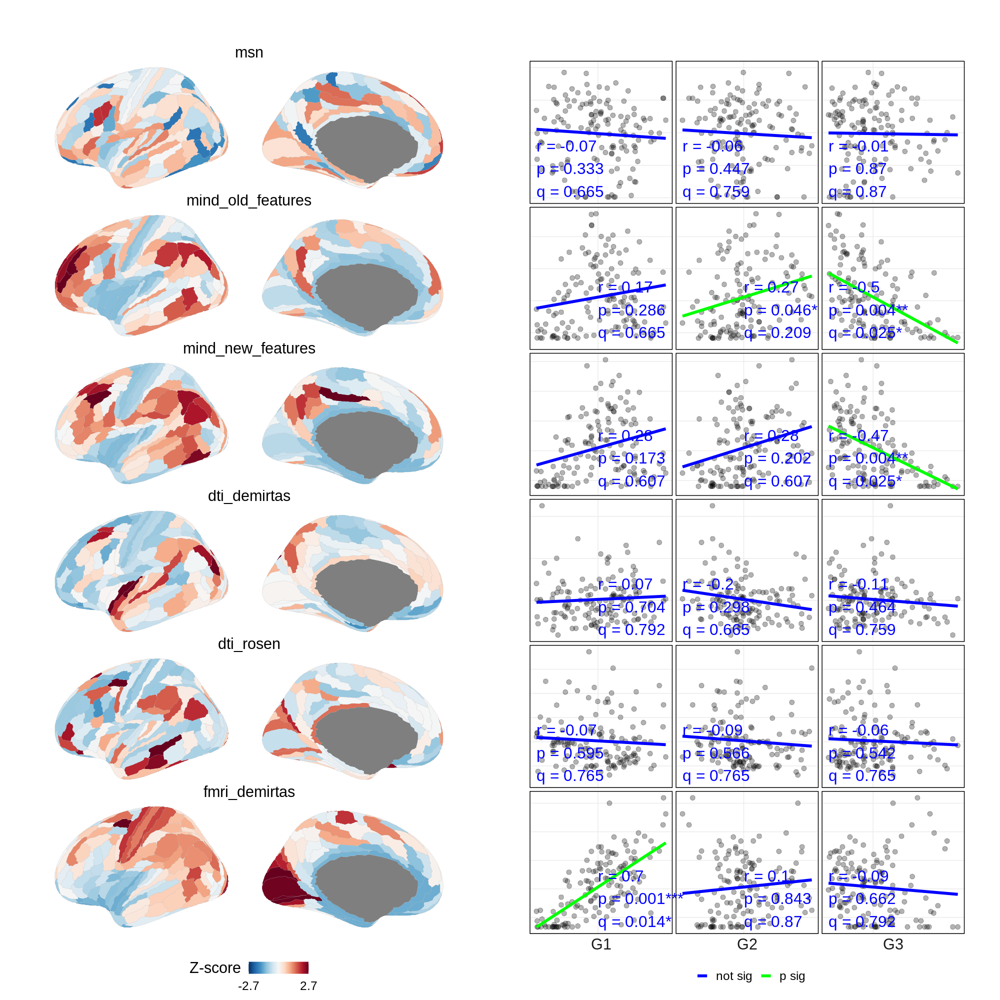

In [1641]:
%%R -i hcp_scores -i maps -i scatter -i null_p -w 20 -h 20 --units in -r 100
source("../code/plot_maps.R")
g0 <- plot_hcp_wide(hcp_scores)
g1 <- plot_maps(maps, ncol=1) & theme(strip.text=element_text(size=22))
g2 <- plot_maps_scatter(scatter, null_p) & theme(text=element_text(size=22), strip.text.y.left=element_blank())
# (g0 / (g1 + g2)) + plot_layout(heights=c(1,4))

g1 + g2

## Thresholded intermodule distance

In [1652]:
def edges_by_module(net, modules, how='intra'):
    # Edge matrix of whether nodes are in same module
    same_module = np.subtract.outer(modules, modules)==0
    if how=='intra':
        return np.where(same_module, net, 0)
    elif how=='inter':
        return np.where(~same_module, net, 0)

In [1653]:
distances = (pd.DataFrame({name:pd.Series((hcp_geodesic * edges_by_module(net, modules[name], how='inter')).sum(0)) 
                          for name, net in networks_bin.items()})
             .set_index(get_labels_hcp()[:180])
             .apply(lambda x: (x-np.mean(x))/np.std(x))
        )

maps = distances

In [1654]:
scatter = (maps
    .melt(ignore_index=False, var_name='map', value_name='map_score')
    .join(hcp_scores.set_index('label'))
    .melt(ignore_index=False, id_vars=['map','map_score'], var_name='G', value_name='G_score')
)

In [1655]:
null_p = (corr_nulls_from_grads(null_scores, hcp_scores, maps, method='pearsonr')
                .join(scatter.groupby(['map','G']).min(), on=('map','G'))
                .rename({'map_score':'y', 'G_score':'x'},axis=1)
)

/opt/conda/lib/python3.10/site-packages/rpy2/robjects/pandas2ri.py:56: UserWarning: DataFrame contains duplicated elements in the index, which will lead to loss of the row names in the resulting data.frame
  warnings.warn('DataFrame contains duplicated elements in the index, '




`geom_smooth()` using formula = 'y ~ x'


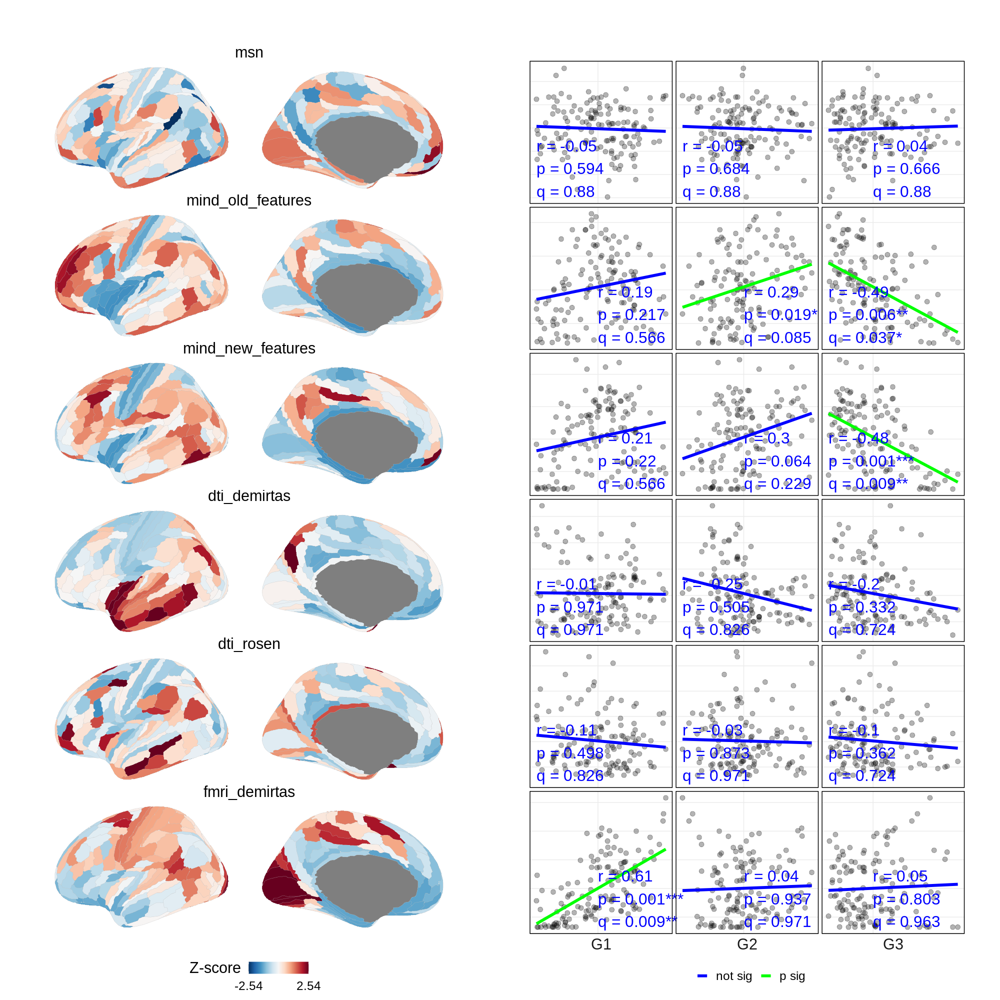

In [1656]:
%%R -i hcp_scores -i maps -i scatter -i null_p -w 20 -h 20 --units in -r 100
source("../code/plot_maps.R")
g0 <- plot_hcp_wide(hcp_scores)
g1 <- plot_maps(maps, ncol=1) & theme(strip.text=element_text(size=22))
g2 <- plot_maps_scatter(scatter, null_p) & theme(text=element_text(size=22), strip.text.y.left=element_blank())
# (g0 / (g1 + g2)) + plot_layout(heights=c(1,4))

g1 + g2

## Chen model for axonal connectivity

In [1733]:
# net = networks_bin['dti_rosen']
# net = networks_bin['fmri_demirtas']
# net = networks_bin['mind_old_features']
# net = networks_bin['mind_new_features']
# net = networks_bin['dti_demirtas']

net = networks['dti_demirtas']
d_i = (net * hcp_geodesic).sum(0) / net.sum(0)
d_i[:10]

array([52.60909146, 14.70986826, 28.79705483, 48.71743232, 47.16454891,
       32.36410676, 23.44216247, 46.21737372, 41.51663484, 26.03327125])

In [1734]:
beta = 0.03
w_i = np.exp(-beta * d_i)
w_i[:10]

array([0.20633118, 0.64320226, 0.42151006, 0.23188286, 0.24294105,
       0.37873323, 0.49496666, 0.24994329, 0.28779725, 0.45794869])

In [1735]:
rTAPL = w_i * 1 # (net * hcp_geodesic).sum(0)
rTAPL[:10]

array([0.20633118, 0.64320226, 0.42151006, 0.23188286, 0.24294105,
       0.37873323, 0.49496666, 0.24994329, 0.28779725, 0.45794869])

In [1736]:
test_maps = get_maps()[['glasser_GI']].assign(axon_length = rTAPL).apply(lambda x: (x-np.mean(x))/np.std(x))

            glasser_GI axon_length
glasser_GI   1.0000000   0.0620232
axon_length  0.0620232   1.0000000


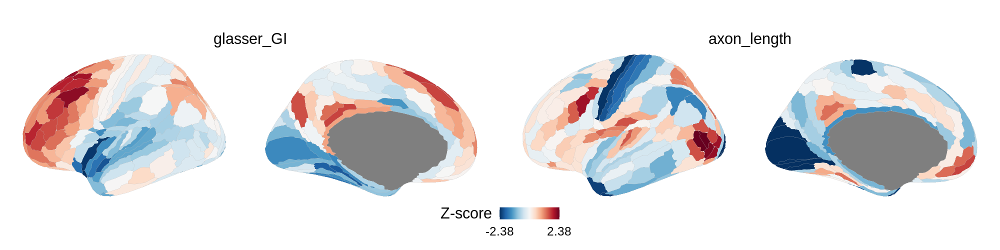

In [1737]:
%%R -i test_maps -w 20 -h 5 -u in -r 100
print(test_maps %>% cor(use='p'))
plot_maps(test_maps, ncol=2)